In [193]:
import pandas as pd
import numpy as np
import seaborn as sns
import scipy
import scipy.cluster.hierarchy as sch
import plotly.express as px
import matplotlib.pyplot as plt
import networkx as nx

from sklearn import preprocessing
from GGLasso.gglasso.problem import glasso_problem
from utils import transform_features, scale_array_by_diagonal
from utils import PCA

from scipy import stats
from scipy.spatial import distance

from networkx.utils import cuthill_mckee_ordering

from bokeh.io import output_notebook, show, save
from bokeh.models import Range1d, Circle, ColumnDataSource, MultiLine, HoverTool, LabelSet
from bokeh.plotting import figure
from bokeh.plotting import from_networkx

In [49]:
def cluster_corr(corr_array, inplace=False):
    """
    Rearranges the correlation matrix, corr_array, so that groups of highly 
    correlated variables are next to eachother 
    
    Parameters
    ----------
    corr_array : pandas.DataFrame or numpy.ndarray
        a NxN correlation matrix 
        
    Returns
    -------
    pandas.DataFrame or numpy.ndarray
        a NxN correlation matrix with the columns and rows rearranged
    """
    pairwise_distances = sch.distance.pdist(corr_array)
    linkage = sch.linkage(pairwise_distances, method='complete')
    cluster_distance_threshold = pairwise_distances.max()/2
    idx_to_cluster_array = sch.fcluster(linkage, cluster_distance_threshold, 
                                        criterion='distance')
    idx = np.argsort(idx_to_cluster_array)
    
    if not inplace:
        corr_array = corr_array.copy()
    
    if isinstance(corr_array, pd.DataFrame):
        return corr_array.iloc[idx, :].T.iloc[idx, :]
    return corr_array[idx, :][:, idx]

In [3]:
# def PC_covariates(raw_data, transformed_data, meta, loadings, eigv, inv_cov, proj)
#     eigv_sum = np.sum(eigv)
#     var_exp = [(value / eigv_sum) for value in sorted(eigv, reverse=True)]

#     x = raw_data.sum(axis=0)
#     seq_depth = pd.DataFrame(data=x, columns=["sequencing depth"])

#     df = transformed_data.join(seq_depth)

#     for col in meta.columns:

#         for i in range(0, rank):

#             x = loadings[:,i]
#             y = inv_cov[col]

#             r_2 = stats.spearmanr(x, y)[0]
#             p_value = stats.spearmanr(x, y)[1]
#             title_1 = "Spearman correlation {0}".format(np.round(r_2, 3))

#             # Find the slope and intercept of the best fit line
#             slope, intercept = np.polyfit(x, y, 1)

#             # Create a list of values in the best fit line
#             abline_values = [slope * i + intercept for i in x]

#             fig, ax = plt.subplots(nrows = 1, ncols = 2, sharex=False, sharey = False, squeeze=False, figsize=(15, 7))
#             ax[0][0].scatter(x, y)
#             ax[0][0].plot(x, abline_values, 'b')
#             ax[0][0].set_xlabel("Principal axis (loading vector) {0}".format(i+1))
#             ax[0][0].set_ylabel("estimated {0}".format(col))
#             ax[0][0].title.set_text(title_1)

#             yabs_max = abs(max(ax[0][0].get_ylim(), key=abs))
#             xabs_max = abs(max(ax[0][0].get_xlim(), key=abs))
#             ax[0][0].set_ylim(ymin=-yabs_max, ymax=yabs_max)
#             ax[0][0].set_xlim(xmin=-xabs_max, xmax=xabs_max)

#             spearman_corr = stats.spearmanr(df[col], proj[:, i])[0]
#             p_value = stats.spearmanr(df[col], proj[:, i])[1]

#             title_2 = "Spearman correlation {0}".format(np.round(spearman_corr, 3))
#             im = ax[0][1].scatter(proj[:, i], df[col], c=df['sequencing depth'], cmap=plt.cm.Blues, vmin=0)
#             cbar = fig.colorbar(im)


#             cbar.set_label("Sampling depth")
#             ax[0][1].set_xlabel("PC{0} ({1}%)".format(i + 1, str(100 * var_exp[i])[:4]))
#             ax[0][1].set_ylabel("{0}".format(col))
#             ax[0][1].title.set_text(title_2)

#             plt.show()
#     #         plt.savefig("plots/pc_plots/scatter_pc_{0}_{1}.png".format(i, col))

# Data

## Raw data

In [4]:
raw = pd.read_csv('data/composition_feature-table.tsv', sep='\t', index_col = 0)

print(raw.shape)
raw.head()

(130, 53)


,BAQ2420.1.1,BAQ2420.1.2,BAQ2420.1.3,BAQ2420.2,BAQ2420.3,BAQ2462.1,BAQ2462.2,BAQ2462.3,BAQ2687.1,BAQ2687.2,...,YUN3533.1.1,YUN3533.1.2,YUN3533.1.3,YUN3533.2,YUN3533.3,YUN3856.1.1,YUN3856.1.2,YUN3856.1.3,YUN3856.2,YUN3856.3
#OTU ID,,,,,,,,,,,,,,,,,,,,,
409faa5f5353e543bf6d99125c7c0e83,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,102.0,181.0,65.0,109.0,0.0,597.0,0.0,129.0,0.0
1237d5925a7176fced9dda961a86c684,0.0,0.0,9.0,92.0,0.0,86.0,57.0,0.0,0.0,0.0,...,0.0,0.0,76.0,958.0,97.0,0.0,0.0,0.0,0.0,0.0
a7b877ae6d2f079a15b6b192a4425620,0.0,0.0,0.0,40.0,50.0,46.0,24.0,69.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,25.0,0.0,0.0
ef3fdbe1dcde754d91130cde6a4b4d61,0.0,25.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,44.0,0.0,83.0,0.0,0.0,0.0,80.0,0.0
96cbccca68ad868a78bb0604e4a41cf5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,39.0,34.0,77.0,55.0,0.0,0.0,0.0,0.0,0.0


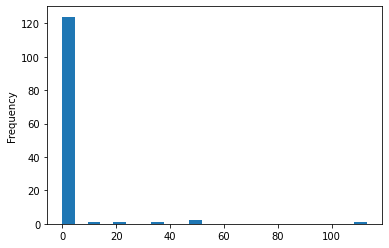

In [5]:
# raw.to_csv("data/count_table.csv", index=True)
raw.iloc[:, 0].plot.hist(bins=24, alpha=1).get_figure().savefig('plots/raw_count.png')

## CLR

In [6]:
clr = transform_features(raw, transformation="clr")
clr.head()

,BAQ2420.1.1,BAQ2420.1.2,BAQ2420.1.3,BAQ2420.2,BAQ2420.3,BAQ2462.1,BAQ2462.2,BAQ2462.3,BAQ2687.1,BAQ2687.2,...,YUN3533.1.1,YUN3533.1.2,YUN3533.1.3,YUN3533.2,YUN3533.3,YUN3856.1.1,YUN3856.1.2,YUN3856.1.3,YUN3856.2,YUN3856.3
#OTU ID,,,,,,,,,,,,,,,,,,,,,
409faa5f5353e543bf6d99125c7c0e83,-0.16777,-0.436407,-0.229753,-0.424645,-0.353991,-0.384811,-0.393926,-0.290604,-0.481342,-0.250646,...,-0.179792,4.270642,4.797162,3.655617,4.162278,-0.213116,5.902041,-0.328879,4.448310,-0.578382
1237d5925a7176fced9dda961a86c684,-0.16777,-0.436407,1.967471,4.097143,-0.353991,4.069537,3.649126,-0.290604,-0.481342,-0.250646,...,-0.179792,-0.354331,3.929399,6.346077,4.045641,-0.213116,-0.489876,-0.328879,-0.411502,-0.578382
a7b877ae6d2f079a15b6b192a4425620,-0.16777,-0.436407,-0.229753,3.264234,3.558032,3.443831,2.784128,3.943502,-0.481342,-0.250646,...,-0.179792,-0.354331,-0.401335,-0.518771,-0.529070,-0.213116,-0.489876,2.889997,-0.411502,-0.578382
ef3fdbe1dcde754d91130cde6a4b4d61,-0.16777,2.782469,-0.229753,-0.424645,-0.353991,-0.384811,-0.393926,-0.290604,-0.481342,-0.250646,...,-0.179792,-0.354331,3.382855,-0.518771,3.889770,-0.213116,-0.489876,-0.328879,3.970525,-0.578382
96cbccca68ad868a78bb0604e4a41cf5,-0.16777,-0.436407,-0.229753,-0.424645,-0.353991,-0.384811,-0.393926,-0.290604,-0.481342,-0.250646,...,-0.179792,3.309231,3.125026,3.825035,3.478263,-0.213116,-0.489876,-0.328879,-0.411502,-0.578382


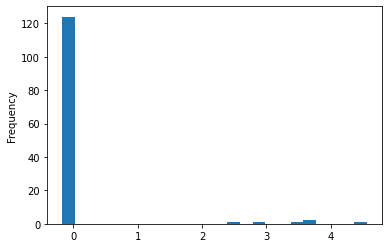

In [7]:
clr.iloc[:, 0].plot.hist(bins=24, alpha=1).get_figure().savefig('plots/clr_count.png')

## Modified CLR

In [8]:
mclr = transform_features(raw, transformation="mclr")
mclr.head()

,BAQ2420.1.1,BAQ2420.1.2,BAQ2420.1.3,BAQ2420.2,BAQ2420.3,BAQ2462.1,BAQ2462.2,BAQ2462.3,BAQ2687.1,BAQ2687.2,...,YUN3533.1.1,YUN3533.1.2,YUN3533.1.3,YUN3533.2,YUN3533.3,YUN3856.1.1,YUN3856.1.2,YUN3856.1.3,YUN3856.2,YUN3856.3
#OTU ID,,,,,,,,,,,,,,,,,,,,,
409faa5f5353e543bf6d99125c7c0e83,0.510611,0.241975,0.448628,0.253736,0.324391,0.293571,0.284456,0.387777,0.19704,0.427736,...,0.49859,4.949024,5.475544,4.333998,4.840660,0.465266,6.580423,0.349503,5.126692,0.1
1237d5925a7176fced9dda961a86c684,0.510611,0.241975,2.645853,4.775525,0.324391,4.747918,4.327508,0.387777,0.19704,0.427736,...,0.49859,0.324051,4.607780,7.024459,4.724023,0.465266,0.188506,0.349503,0.266880,0.1
a7b877ae6d2f079a15b6b192a4425620,0.510611,0.241975,0.448628,3.942616,4.236414,4.122212,3.462510,4.621884,0.19704,0.427736,...,0.49859,0.324051,0.277047,0.159611,0.149312,0.465266,0.188506,3.568379,0.266880,0.1
ef3fdbe1dcde754d91130cde6a4b4d61,0.510611,3.460851,0.448628,0.253736,0.324391,0.293571,0.284456,0.387777,0.19704,0.427736,...,0.49859,0.324051,4.061237,0.159611,4.568152,0.465266,0.188506,0.349503,4.648906,0.1
96cbccca68ad868a78bb0604e4a41cf5,0.510611,0.241975,0.448628,0.253736,0.324391,0.293571,0.284456,0.387777,0.19704,0.427736,...,0.49859,3.987612,3.803408,4.503417,4.156645,0.465266,0.188506,0.349503,0.266880,0.1


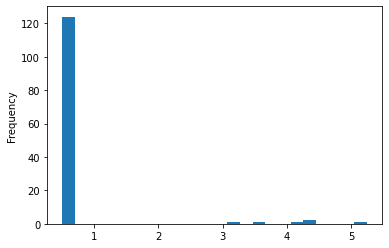

In [9]:
mclr.iloc[:, 0].plot.hist(bins=24, alpha=1).get_figure().savefig('plots/mclr_count.png')

## Covariates

In [10]:
# covariates
meta = pd.read_csv('data/acm_meta.tsv', sep='\t', index_col = 0)

# select only numeric features
meta = meta.loc[:, meta.iloc[0, :] != 'categorical']
meta = meta.apply(pd.to_numeric, errors='coerce')

# drop QIIME2 header
meta = meta.iloc[1:]
# fill missing values with zeros
meta = meta.fillna(0)

print(meta.shape)
meta.head()

(75, 15)


,elevation,extract-concen,amplicon-concentration,depth,ph,toc,ec,average-soil-relative-humidity,relative-humidity-soil-high,relative-humidity-soil-low,percent-relative-humidity-soil-100,average-soil-temperature,temperature-soil-high,temperature-soil-low,percentcover
sample-id,,,,,,,,,,,,,,,
BAQ1370.1.2,1370.0,0.019,0.95,2.0,7.98,525.0,6.080,16.17,23.97,11.42,0.0,22.61,35.21,12.46,0.0
BAQ1370.3,1370.0,0.124,17.46,2.0,0.00,771.0,6.080,16.17,23.97,11.42,0.0,22.61,35.21,12.46,0.0
BAQ1370.1.3,1370.0,1.200,0.96,3.0,8.13,0.0,0.000,16.17,23.97,11.42,0.0,22.61,35.21,12.46,0.0
BAQ1552.1.1,1552.0,0.722,18.83,1.0,7.87,0.0,0.000,15.75,35.36,11.10,0.0,22.63,30.65,10.96,0.0
BAQ1552.2,1552.0,0.017,2.00,2.0,0.00,223.0,1.839,15.75,35.36,11.10,0.0,22.63,30.65,10.96,0.0


array([<AxesSubplot:title={'center':'elevation'}>,
       <AxesSubplot:title={'center':'extract-concen'}>,
       <AxesSubplot:title={'center':'amplicon-concentration'}>,
       <AxesSubplot:title={'center':'depth'}>,
       <AxesSubplot:title={'center':'ph'}>,
       <AxesSubplot:title={'center':'toc'}>,
       <AxesSubplot:title={'center':'ec'}>,
       <AxesSubplot:title={'center':'average-soil-relative-humidity'}>,
       <AxesSubplot:title={'center':'relative-humidity-soil-high'}>,
       <AxesSubplot:title={'center':'relative-humidity-soil-low'}>,
       <AxesSubplot:title={'center':'percent-relative-humidity-soil-100'}>,
       <AxesSubplot:title={'center':'average-soil-temperature'}>,
       <AxesSubplot:title={'center':'temperature-soil-high'}>,
       <AxesSubplot:title={'center':'temperature-soil-low'}>,
       <AxesSubplot:title={'center':'percentcover'}>], dtype=object)

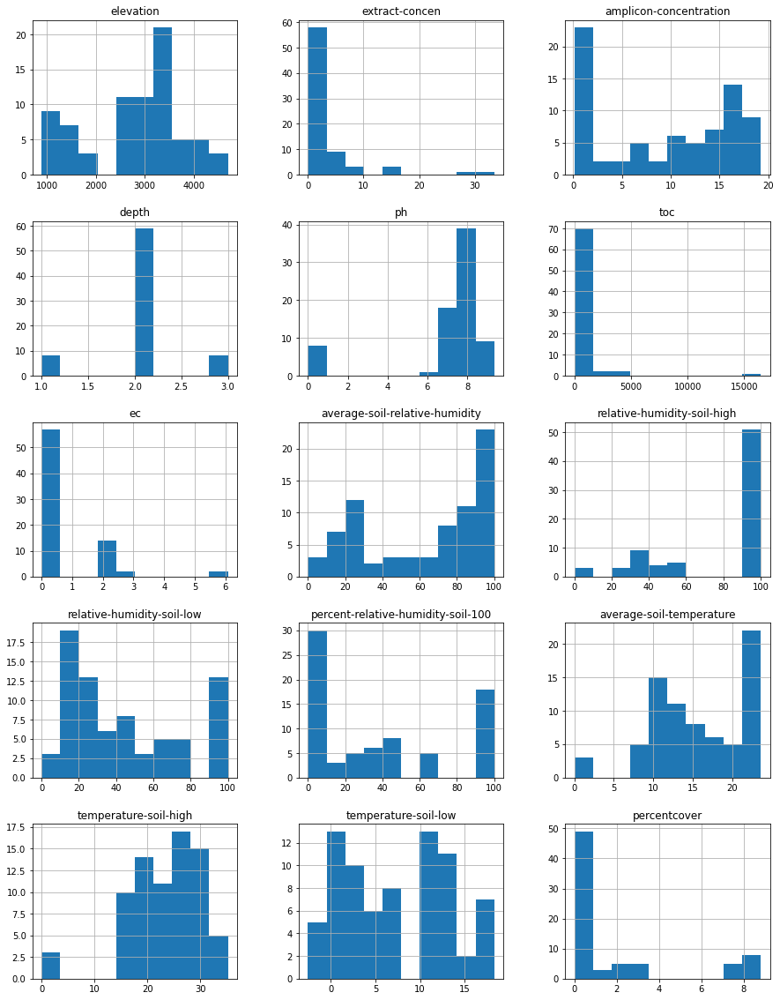

In [11]:
fig, axis = plt.subplots(5,3,figsize=(15, 20))
meta.hist(ax=axis)

# fig.savefig('plots/meta_unscaled.png')

## Scale covariates

In [12]:
scaler = preprocessing.StandardScaler().fit(meta)
meta_scaled = scaler.transform(meta)

meta_scaled = pd.DataFrame(meta_scaled, index=meta.index, columns=meta.columns)
meta_scaled.head()

,elevation,extract-concen,amplicon-concentration,depth,ph,toc,ec,average-soil-relative-humidity,relative-humidity-soil-high,relative-humidity-soil-low,percent-relative-humidity-soil-100,average-soil-temperature,temperature-soil-high,temperature-soil-low,percentcover
sample-id,,,,,,,,,,,,,,,
BAQ1370.1.2,-1.444382,-0.491764,-1.270117,0.000000,0.368754,-0.086769,4.271529,-1.413475,-1.710932,-0.994979,-0.966304,1.196256,1.711718,0.882451,-0.602138
BAQ1370.3,-1.444382,-0.474017,1.171543,0.000000,-2.802209,0.039684,4.271529,-1.413475,-1.710932,-0.994979,-0.966304,1.196256,1.711718,0.882451,-0.602138
BAQ1370.1.3,-1.444382,-0.292154,-1.268638,2.165064,0.428358,-0.356639,-0.574897,-1.413475,-1.710932,-0.994979,-0.966304,1.196256,1.711718,0.882451,-0.602138
BAQ1552.1.1,-1.263727,-0.372945,1.374152,-2.165064,0.325044,-0.356639,-0.574897,-1.426080,-1.353652,-1.004866,-0.966304,1.199730,1.038703,0.628925,-0.602138
BAQ1552.2,-1.263727,-0.492102,-1.114832,0.000000,-2.802209,-0.242008,0.890988,-1.426080,-1.353652,-1.004866,-0.966304,1.199730,1.038703,0.628925,-0.602138


array([<AxesSubplot:title={'center':'elevation'}>,
       <AxesSubplot:title={'center':'extract-concen'}>,
       <AxesSubplot:title={'center':'amplicon-concentration'}>,
       <AxesSubplot:title={'center':'depth'}>,
       <AxesSubplot:title={'center':'ph'}>,
       <AxesSubplot:title={'center':'toc'}>,
       <AxesSubplot:title={'center':'ec'}>,
       <AxesSubplot:title={'center':'average-soil-relative-humidity'}>,
       <AxesSubplot:title={'center':'relative-humidity-soil-high'}>,
       <AxesSubplot:title={'center':'relative-humidity-soil-low'}>,
       <AxesSubplot:title={'center':'percent-relative-humidity-soil-100'}>,
       <AxesSubplot:title={'center':'average-soil-temperature'}>,
       <AxesSubplot:title={'center':'temperature-soil-high'}>,
       <AxesSubplot:title={'center':'temperature-soil-low'}>,
       <AxesSubplot:title={'center':'percentcover'}>], dtype=object)

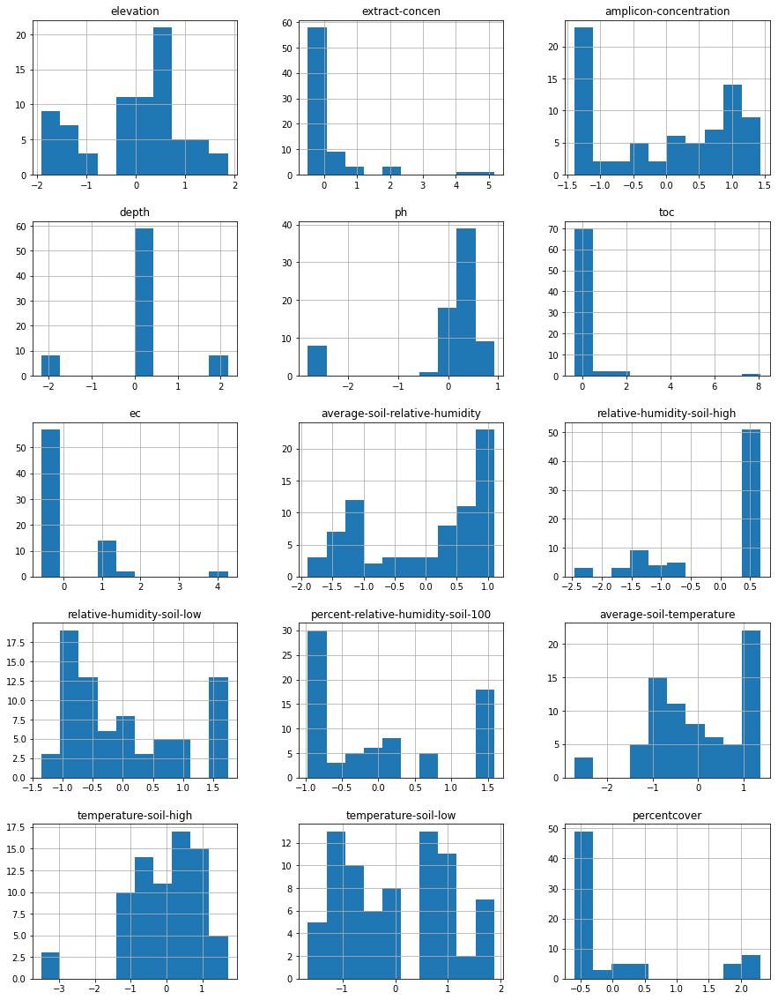

In [13]:
fig, axis = plt.subplots(5,3,figsize=(15, 20))
meta_scaled.hist(ax=axis)

# fig.savefig('plots/meta_scaled.png')

## Merge data with covariates

In [14]:
# # transpose count data
# mclr_T = mclr.T
# # join by sample id
# df = mclr_T.join(meta_scaled)

# transpose count data
clr_T = clr.T
# join by sample id
df = clr_T.join(meta_scaled)

#check if any missing values
print("Any missing values?: {0}".format(df.isnull().sum().any()))
print(df.shape)
df.head()

Any missing values?: False
(53, 145)


,409faa5f5353e543bf6d99125c7c0e83,1237d5925a7176fced9dda961a86c684,a7b877ae6d2f079a15b6b192a4425620,ef3fdbe1dcde754d91130cde6a4b4d61,96cbccca68ad868a78bb0604e4a41cf5,11f7b172e09b77715d3bb2175a40b409,1694836fc379411d2b9aa087d68d571b,a36b38f754f6abd278aeb9dbc7696343,ffd60d684f32e6fd5b47fe90095f9d34,c6a6705874a49360a01c2b3fd39fe900,...,toc,ec,average-soil-relative-humidity,relative-humidity-soil-high,relative-humidity-soil-low,percent-relative-humidity-soil-100,average-soil-temperature,temperature-soil-high,temperature-soil-low,percentcover
BAQ2420.1.1,-0.167770,-0.167770,-0.167770,-0.167770,-0.167770,-0.167770,-0.167770,4.559617,-0.167770,-0.167770,...,-0.356639,-0.574897,0.578402,0.673964,-0.076802,0.227264,1.168465,0.691421,1.023412,-0.602138
BAQ2420.1.2,-0.436407,-0.436407,-0.436407,2.782469,-0.436407,2.271643,-0.436407,-0.436407,-0.436407,-0.436407,...,-0.271309,-0.515113,0.578402,0.673964,-0.076802,0.227264,1.168465,0.691421,1.023412,-0.602138
BAQ2420.1.3,-0.229753,1.967471,-0.229753,-0.229753,-0.229753,-0.229753,-0.229753,-0.229753,-0.229753,-0.229753,...,-0.356639,-0.574897,0.578402,0.673964,-0.076802,0.227264,1.168465,0.691421,1.023412,-0.602138
BAQ2420.2,-0.424645,4.097143,3.264234,-0.424645,-0.424645,2.907559,-0.424645,-0.424645,-0.424645,-0.424645,...,-0.183408,-0.515113,0.578402,0.673964,-0.076802,0.227264,1.168465,0.691421,1.023412,-0.602138
BAQ2420.3,-0.353991,-0.353991,3.558032,-0.353991,-0.353991,2.418598,-0.353991,3.407209,-0.353991,-0.353991,...,-0.061582,-0.515113,0.578402,0.673964,-0.076802,0.227264,1.168465,0.691421,1.023412,-0.602138


In [15]:
# Rename long feature IDs with concise names
vis_df = df.copy()
id_dict = dict()

i = 1
for col in vis_df.columns:
    # length of ASVs identifier
    if len(col) == 32:
        asv_name = "ASV_{0}".format(i)
        id_dict[asv_name] = col
        vis_df.rename(columns={col: asv_name}, inplace=True)
        
        i += 1

In [20]:
#shuffling
n_cov = 15
only_cov = vis_df.iloc[:, -n_cov:]

vis_df_2 = vis_df.iloc[:, :-n_cov].sample(frac=1)
a = vis_df_2.values
b= only_cov.values
c = np.hstack((a,b))
vis_df_2 = pd.DataFrame(data=c, index=vis_df_2.index, columns=vis_df.columns)

vis_df_3 = vis_df.iloc[:, :-n_cov].sample(frac=1)
d = vis_df_3.values
e = np.hstack((d,b))
vis_df_3 = pd.DataFrame(data=e, index=vis_df_3.index, columns=vis_df.columns)

## Covariance

In [21]:
n_cov = meta_scaled.shape[1]
asv = df.iloc[:, :-n_cov]
S = np.cov(asv.T.values, bias=True)

# correlation between ASVs ONLY
corr = scale_array_by_diagonal(S)

asv_names = vis_df.iloc[:, :-n_cov].columns
vis_S = pd.DataFrame(corr, columns=asv_names, index=asv_names)
print(vis_S.shape)
vis_S.head()

(130, 130)


,ASV_1,ASV_2,ASV_3,ASV_4,ASV_5,ASV_6,ASV_7,ASV_8,ASV_9,ASV_10,...,ASV_121,ASV_122,ASV_123,ASV_124,ASV_125,ASV_126,ASV_127,ASV_128,ASV_129,ASV_130
ASV_1,1.000000,0.235220,-0.300181,0.125571,0.179510,-0.038352,0.017890,-0.245254,-0.155529,-0.149668,...,0.438898,0.504847,-0.195431,-0.114226,-0.127345,-0.181318,-0.192322,-0.018626,0.073116,-0.159134
ASV_2,0.235220,1.000000,0.115052,-0.113347,0.271909,-0.096653,-0.193164,-0.165456,-0.200931,-0.058737,...,0.720405,0.531381,0.180252,-0.080613,-0.094829,0.333577,-0.147450,-0.149192,0.061652,-0.119690
ASV_3,-0.300181,0.115052,1.000000,-0.177694,-0.238362,0.148623,-0.214250,0.323172,-0.064146,0.277089,...,-0.125576,-0.185793,0.153479,-0.023443,-0.034526,0.420531,-0.117474,-0.098907,0.141218,-0.079335
ASV_4,0.125571,-0.113347,-0.177694,1.000000,0.146477,0.120237,0.127034,-0.316576,0.229645,0.066499,...,0.101542,-0.030321,-0.141483,-0.130383,0.081982,-0.238298,-0.081075,-0.225834,0.141583,0.036861
ASV_5,0.179510,0.271909,-0.238362,0.146477,1.000000,-0.234617,0.462486,-0.190860,0.251317,-0.204029,...,0.442808,0.297917,-0.163554,-0.097192,-0.111191,-0.154218,-0.165839,-0.166289,-0.151280,-0.136978


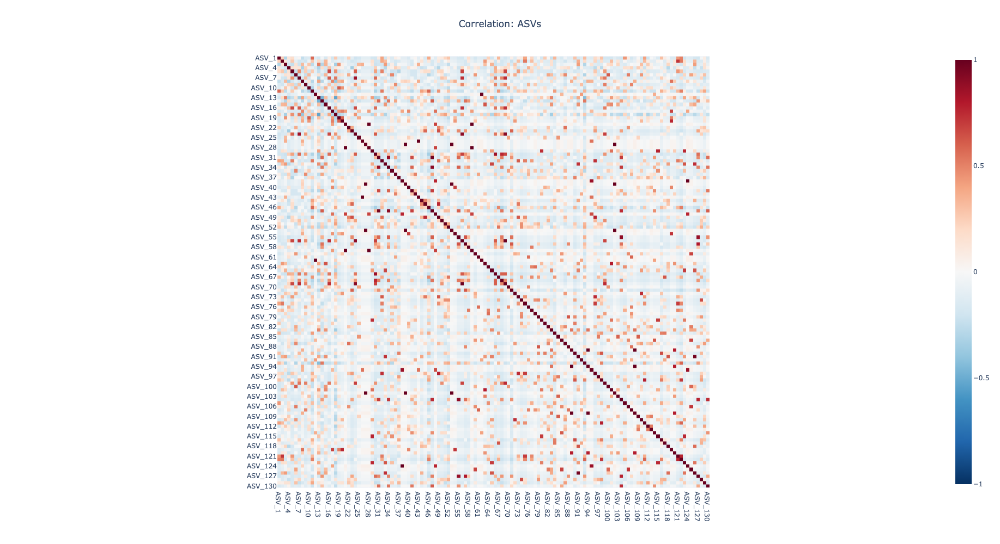

In [22]:
fig = px.imshow(vis_S, color_continuous_scale='RdBu_r', zmin=-1, zmax=1)
fig.update_layout(margin = dict(t=100,r=100,b=100,l=100), width = 1000, height = 1000,
                 title='Correlation: ASVs', title_x=0.5)

# fig.write_image("plots/asv_correlation.png")

In [23]:
S_meta_1 = np.cov(df.T.values, bias=True)

S_meta_2 = np.cov(vis_df_2.T.values, bias=True)
S_meta_3 = np.cov(vis_df_3.T.values, bias=True)


# # correlation between ASVs and covariates
corr_meta_1 = scale_array_by_diagonal(S_meta_1)
corr_meta_2 = scale_array_by_diagonal(S_meta_2)
corr_meta_3 = scale_array_by_diagonal(S_meta_3)

vis_S_meta_1 = pd.DataFrame(corr_meta_1, columns=vis_df.columns, index=vis_df.columns)
vis_S_meta_2 = pd.DataFrame(corr_meta_2, columns=vis_df_2.columns, index=vis_df_2.columns)
vis_S_meta_3 = pd.DataFrame(corr_meta_3, columns=vis_df_3.columns, index=vis_df_3.columns)
vis_S_meta_1.shape, vis_S_meta_2.shape, vis_S_meta_3.shape

((145, 145), (145, 145), (145, 145))

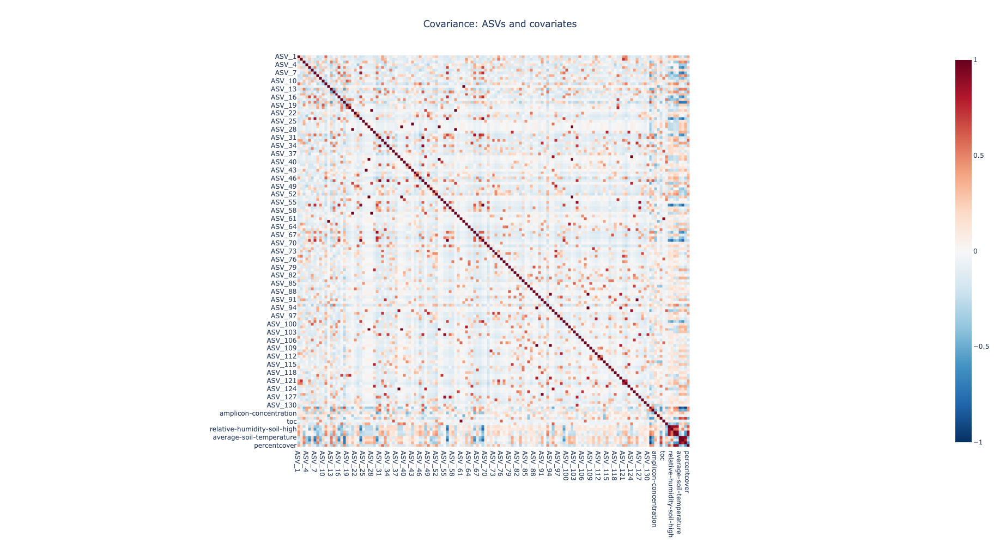

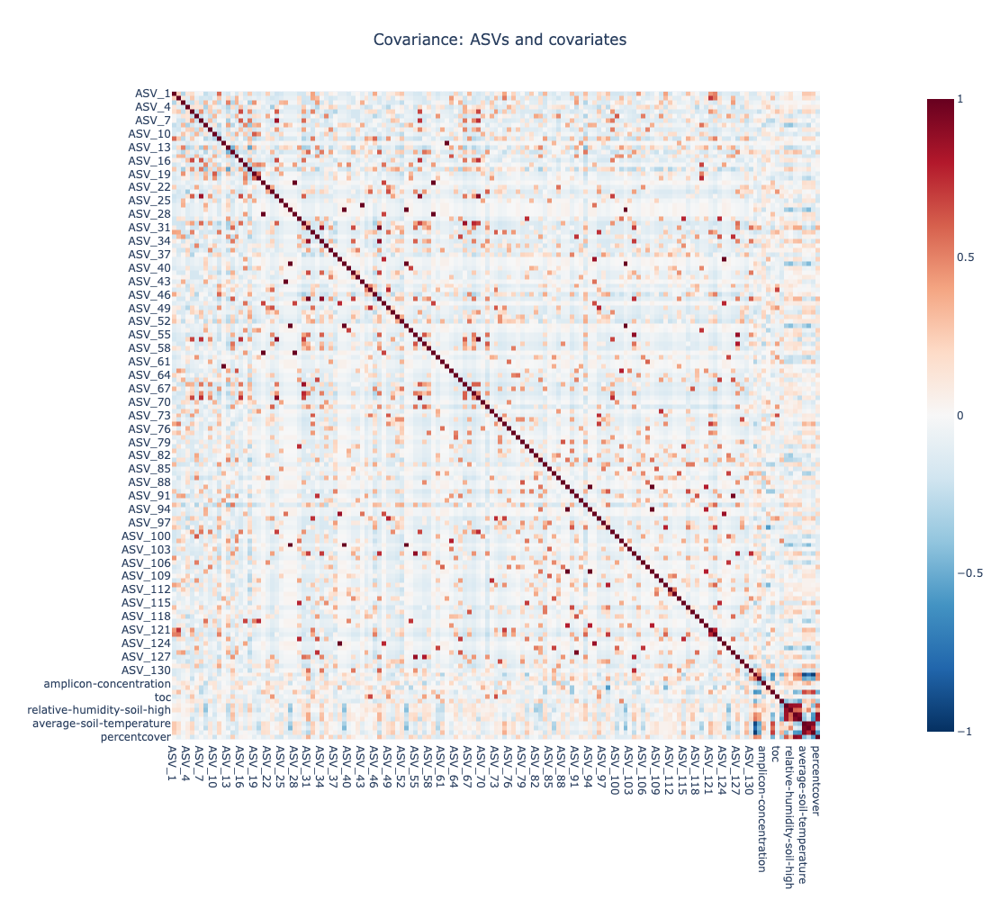

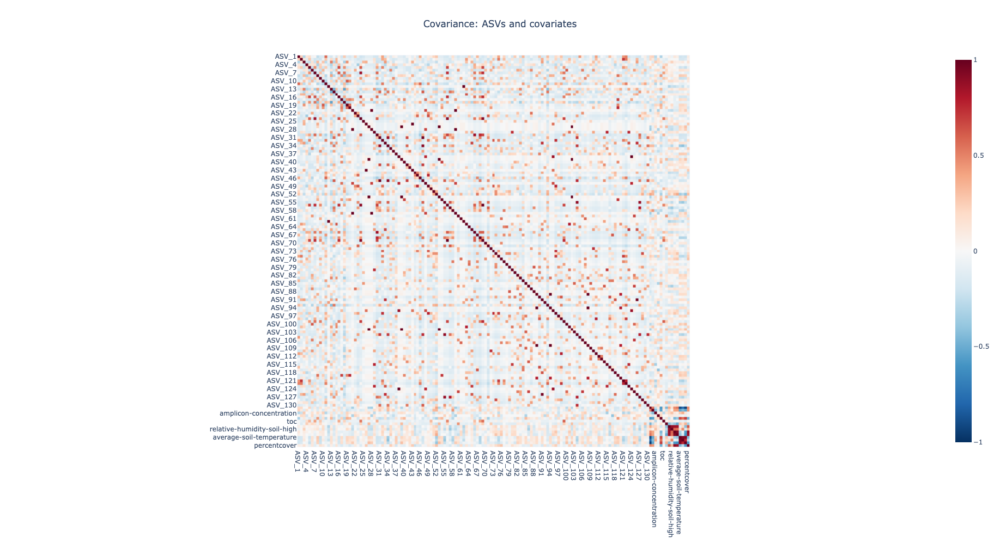

In [24]:
for S_meta in [vis_S_meta_1, vis_S_meta_2, vis_S_meta_3]:
    fig = px.imshow(S_meta, color_continuous_scale='RdBu_r', zmin=-1, zmax=1)
    fig.update_layout(margin = dict(t=100,r=100,b=100,l=100), width = 1000, height = 1000,
                     title='Covariance: ASVs and covariates', title_x=0.5)
    fig.show()

# fig.write_image("plots/asv_and_covariates_correlation.png")

# Models

In [25]:
N = asv.shape[0]
p = asv.shape[1]
print("Shape of data without covariates: {0}, {1}".format(N, p))

N_meta = df.shape[0]
p_meta = df.shape[1]
print("Shape of data with covariates: {0}, {1}".format(N_meta, p_meta))

Shape of data without covariates: 53, 130
Shape of data with covariates: 53, 145


In [26]:
lambda1_range = np.logspace(0, -4, 15)
# mu1_range = np.logspace(2, -1, 10)
mu1_range = np.logspace(0.9, 0.4, 10)

modelselect_params = {'lambda1_range': lambda1_range, 'mu1_range': mu1_range}

In [27]:
P_SGL = glasso_problem(corr, N, latent=False, do_scaling=False)
P_SGL

 
SINGLE GRAPHICAL LASSO PROBLEM 
Regularization parameters:
{'lambda1': None, 'mu1': None}

In [28]:
P_SGL.model_selection(modelselect_params=modelselect_params, method='eBIC', gamma=0.1)
print(P_SGL.reg_params)

ADMM terminated after 39 iterations with status: optimal.
ADMM terminated after 25 iterations with status: optimal.
ADMM terminated after 39 iterations with status: optimal.
ADMM terminated after 10 iterations with status: optimal.
ADMM terminated after 34 iterations with status: optimal.
ADMM terminated after 11 iterations with status: optimal.
ADMM terminated after 10 iterations with status: optimal.
ADMM terminated after 21 iterations with status: optimal.
ADMM terminated after 16 iterations with status: optimal.
ADMM terminated after 23 iterations with status: optimal.
ADMM terminated after 11 iterations with status: optimal.
ADMM terminated after 9 iterations with status: optimal.
ADMM terminated after 9 iterations with status: optimal.
ADMM terminated after 28 iterations with status: optimal.
ADMM terminated after 27 iterations with status: optimal.
ADMM terminated after 12 iterations with status: optimal.
ADMM terminated after 118 iterations with status: optimal.
ADMM terminated

In [29]:
for stat in ['AIC', 'SP', 'RANK', 'LAMBDA', 'MU', 'BEST']:
    print(stat)
    print(P_SGL.modelselect_stats[stat])

AIC
[[  6890.        ]
 [  5341.38656392]
 [  3200.43277988]
 [  1759.81270699]
 [   130.32724736]
 [ -1439.49809782]
 [ -3118.76110706]
 [ -5058.23008016]
 [ -7086.7917123 ]
 [ -9186.21781142]
 [-11304.87968507]
 [-12870.83151624]
 [-14546.32124126]
 [-16079.63389393]
 [-17556.19505858]]
SP
[[0.        ]
 [0.01788909]
 [0.05652952]
 [0.14716756]
 [0.23673226]
 [0.33655337]
 [0.43625522]
 [0.51532499]
 [0.58067979]
 [0.63053071]
 [0.66440072]
 [0.70971974]
 [0.74382826]
 [0.77829457]
 [0.80667859]]
RANK
[[0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]]
LAMBDA
[[1.00000000e+00]
 [5.17947468e-01]
 [2.68269580e-01]
 [1.38949549e-01]
 [7.19685673e-02]
 [3.72759372e-02]
 [1.93069773e-02]
 [1.00000000e-02]
 [5.17947468e-03]
 [2.68269580e-03]
 [1.38949549e-03]
 [7.19685673e-04]
 [3.72759372e-04]
 [1.93069773e-04]
 [1.00000000e-04]]
MU
[[0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]]
BEST
{'lambda1': 0.2682695795279726, 'mu1':

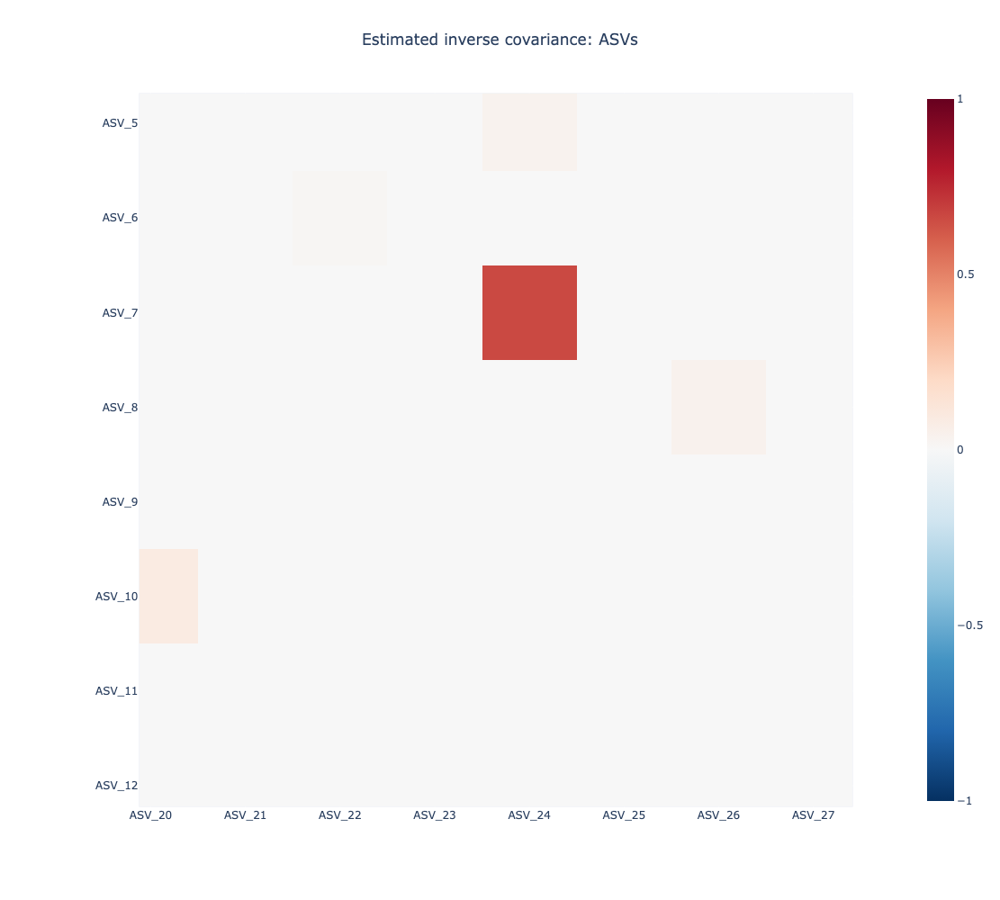

In [30]:
precision_SGL = pd.DataFrame(P_SGL.solution.precision_, columns=asv_names, index=asv_names)

fig = px.imshow(-1*precision_SGL, color_continuous_scale='RdBu_r', zmin=-1, zmax=1)
fig.update_layout(margin = dict(t=100,r=100,b=100,l=100), width = 1000, height = 1000,
                 title='Estimated inverse covariance: ASVs', title_x=0.5)
# fig.write_image("plots/SGL_theta.png")

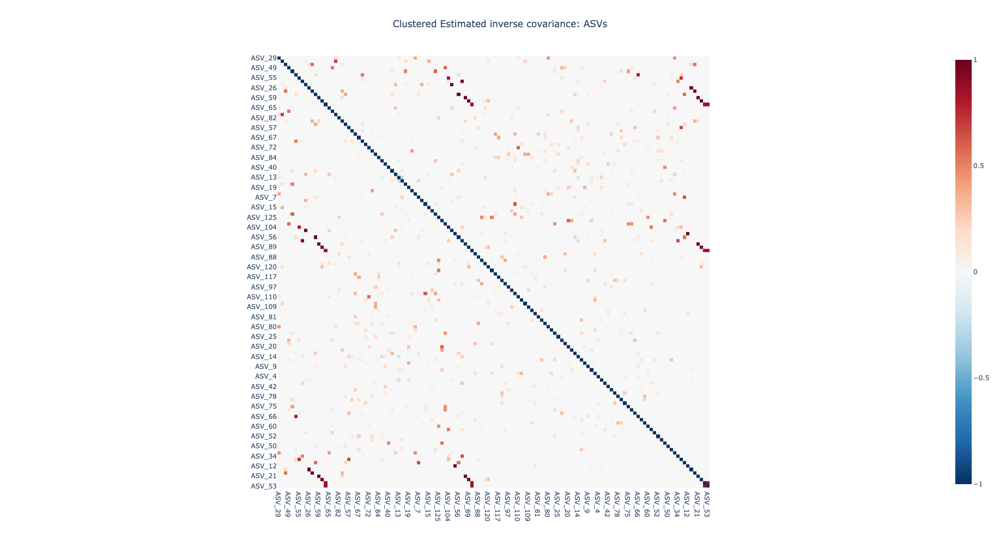

In [51]:
fig = px.imshow(-1*cluster_corr(precision_SGL), color_continuous_scale='RdBu_r', zmin=-1, zmax=1)
fig.update_layout(margin = dict(t=100,r=100,b=100,l=100), width = 1000, height = 1000,
                 title='Clustered Estimated inverse covariance: ASVs', title_x=0.5)

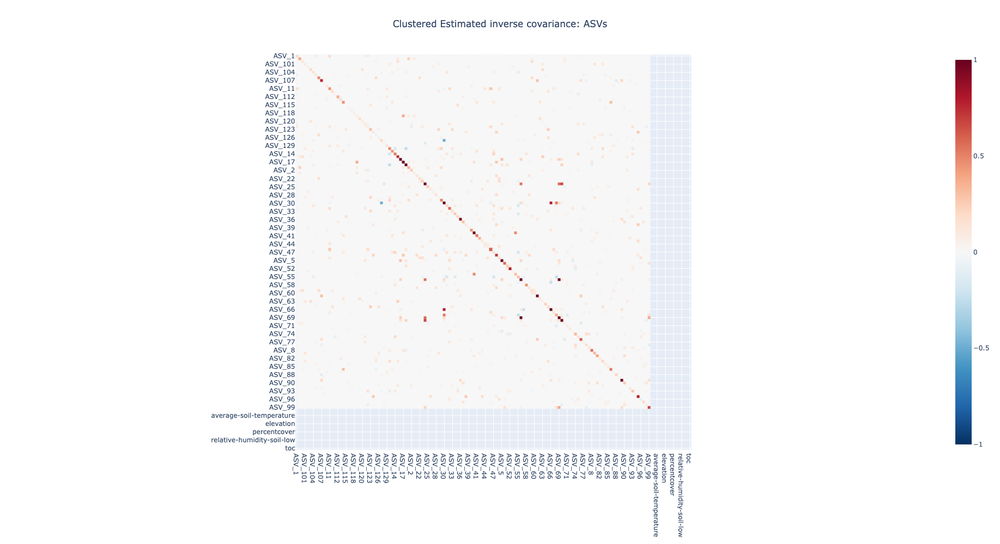

In [247]:
a = precision_SGL - precision_adapt

fig = px.imshow(-1*a, color_continuous_scale='RdBu_r', zmin=-1, zmax=1)
fig.update_layout(margin = dict(t=100,r=100,b=100,l=100), width = 1000, height = 1000,
                 title='Clustered Estimated inverse covariance: ASVs', title_x=0.5)

**Statement 1**:

We know that environment has a large impact on microbial composition.
We would like to investigate this effect and run single graphical lasso model while accounting for latent components.

## SGL + low-rank

In [31]:
P_SGL_low = glasso_problem(corr, N, latent=True, do_scaling=False)
print(P_SGL_low)

 
SINGLE GRAPHICAL LASSO PROBLEM WITH LATENT VARIABLES
Regularization parameters:
{'lambda1': None, 'mu1': None}


In [32]:
P_SGL_low.model_selection(modelselect_params=modelselect_params, method='eBIC', gamma=0.1)
print(P_SGL_low.reg_params)

ADMM terminated after 22 iterations with status: optimal.
ADMM terminated after 22 iterations with status: optimal.
ADMM terminated after 21 iterations with status: optimal.
ADMM terminated after 20 iterations with status: optimal.
ADMM terminated after 20 iterations with status: optimal.
ADMM terminated after 21 iterations with status: optimal.
ADMM terminated after 22 iterations with status: optimal.
ADMM terminated after 23 iterations with status: optimal.
ADMM terminated after 24 iterations with status: optimal.
ADMM terminated after 25 iterations with status: optimal.
ADMM terminated after 34 iterations with status: optimal.
ADMM terminated after 32 iterations with status: optimal.
ADMM terminated after 29 iterations with status: optimal.
ADMM terminated after 28 iterations with status: optimal.
ADMM terminated after 26 iterations with status: optimal.
ADMM terminated after 25 iterations with status: optimal.
ADMM terminated after 25 iterations with status: optimal.
ADMM terminate

In [33]:
for stat in ['AIC', 'SP', 'RANK', 'LAMBDA', 'MU', 'BEST']:
    print(stat)
    print(P_SGL_low.modelselect_stats[stat])

AIC
[[  6895.41982151   6902.89153135   6918.63354208   6942.24017636
    6976.82784716   7026.35144079   7086.78399585   7161.45184007
    7263.74366807   7406.62093139]
 [  5435.31957019   5514.1218117    5604.50081203   5746.11803452
    5889.44934179   6062.91726551   6239.64452912   6388.06218081
    6541.98592738   6727.29432346]
 [  3200.43831275   3215.41703603   3238.76958948   3302.0474056
    3377.29012042   3488.90849085   3657.80320875   3896.34714579
    4159.83373055   4487.27265717]
 [  1759.81135817   1758.7687452    1758.63994847   1758.62464177
    1758.62281205   1758.62259258   1758.39195147   1765.20890869
    1787.7481078    1848.29009512]
 [   130.30333577    128.19623595    127.62393684    127.24507053
     126.99684227    126.82389896    126.70265899    126.61751645
     126.55767589    126.51559697]
 [ -1439.50724124  -1434.43282913  -1434.0071615   -1434.47577883
   -1434.83672046  -1435.15928899  -1435.41593519  -1435.6226555
   -1435.80126386  -1435.972300

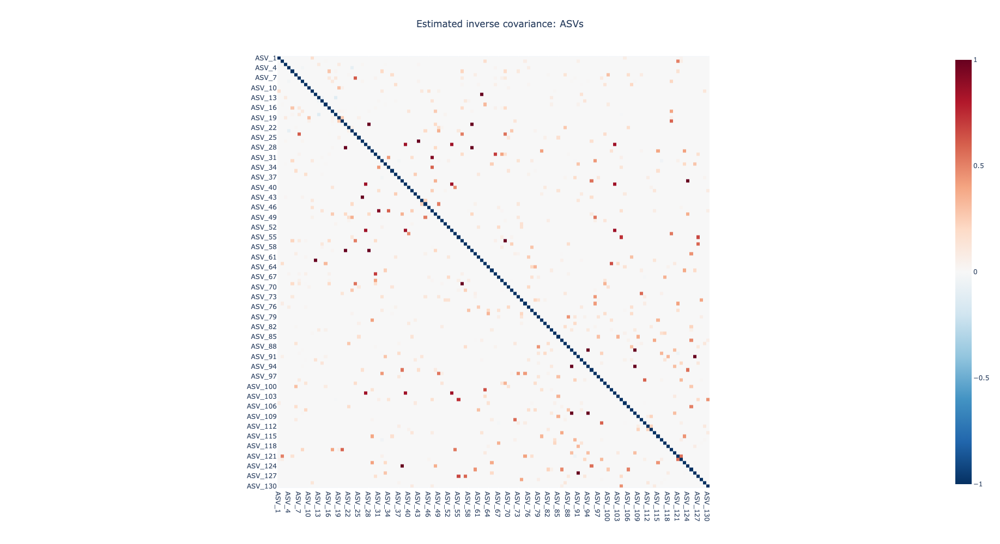

In [34]:
precision_SGL_low = pd.DataFrame(P_SGL_low.solution.precision_, columns=asv_names, index=asv_names)

fig = px.imshow(-1*precision_SGL_low, color_continuous_scale='RdBu_r', zmin=-1, zmax=1)
fig.update_layout(margin = dict(t=100,r=100,b=100,l=100), width = 1000, height = 1000,
                 title='Estimated inverse covariance: ASVs', title_x=0.5)

# fig.write_image("plots/sgl_asv_only.png")

<!-- **Statement 2**:

According to the models selection statistics, the chosen optimal hyperparameters lay in the middle of the grid and we have reached a global minimum of our function. Yet we can try to find such hyperparameters which give us low-rank solutions with the rank of our interest, e.g., from 0 to 10 as well as desired data sparsity level. -->

**Statement 3**:

Imagine we don't have covariate information.

The Graphical Lasso solution is of the form Θ−𝐿 where Θ is sparse and 𝐿 has low rank. We use the low rank component of the Graphical Lasso solution in order to do a robust PCA. For this, we use the eigendecomposition 𝐿=𝑉Σ𝑉𝑇 where the columns of 𝑉 are the orthonormal eigenvecors and Σ is diagonal containing the eigenvalues. Denote the columns of 𝑉 corresponding only to positive eigenvalues with 𝑉̃ ∈ℝ𝑝×𝑟 and Σ̃ ∈ℝ𝑟×𝑟 accordingly, where 𝑟=rank(𝐿). Then we have 𝐿=𝑉̃ Σ̃ 𝑉̃ 𝑇.
Now we project the data matrix 𝑋∈ℝ𝑝×𝑁 onto the eigenspaces of 𝐿−1 - which are the same as of 𝐿 - by computing:

**Statement 4**:

Alternatively, we could solve SGL with adaptive penalization and covariance matrix where covariates are included. So, we could see if loading vectors of PCA we found with the previous model where was no information about covariates are correlated with the solution where we include covariate information. Thus, we could argue that SGL model with low-rank component can capture the information which is unknown but important for microbial composition.

## SGL with covariates and adaptive penalization procedure

In [35]:
# create lambda matrix full of zeros
shape_meta = (p_meta, p_meta)
mask = np.zeros(shape_meta)

# add small constant, so ADMM could converge
mask = mask + 0.01

# heavy penalize species
n_bugs = len(asv.columns)
bugs_block = np.ones((n_bugs, n_bugs))
mask[0:n_bugs, 0:n_bugs] += bugs_block - 0.01
lambda1_mask_exp = mask

In [36]:
lambda1_mask_exp.shape

(145, 145)

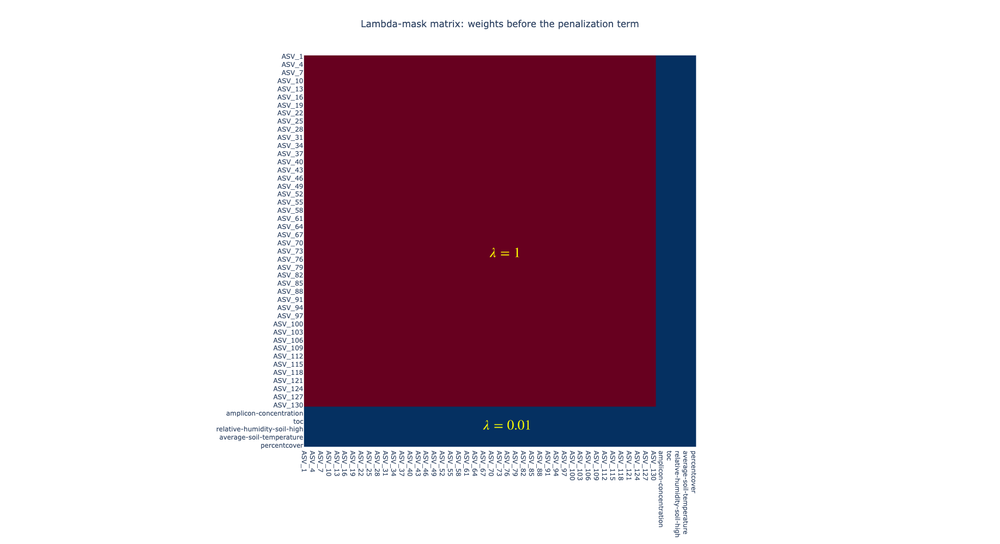

In [37]:
df_mask_exp = pd.DataFrame(lambda1_mask_exp, columns=vis_df.columns, index=vis_df.columns)

fig = px.imshow(df_mask_exp, color_continuous_scale='RdBu_r')
fig.update_layout(margin = dict(t=100,r=100,b=100,l=100), width = 1000, height = 1000,
                 title='Lambda-mask matrix: weights before the penalization term', title_x=0.5)

fig.add_annotation(text="$\lambda=1$",
                  xref="paper", yref="paper", font=dict(color='yellow',size=155),
                  x=0.5, y=0.5, showarrow=False)
fig.add_annotation(text="$\lambda=0.01$",
                  xref="paper", yref="paper", font=dict(color='yellow',size=155),
                  x=0.5, y=0.05, showarrow=False)

fig.update_coloraxes(showscale=False)

# fig.write_image("plots/lambda_mask.png")

In [38]:
modelselect_params["lambda1_mask"] = lambda1_mask_exp

In [39]:
P_SGL_adapt = glasso_problem(vis_S_meta_1.values, N_meta, latent=False, do_scaling=False)
print(P_SGL_adapt)

 
SINGLE GRAPHICAL LASSO PROBLEM 
Regularization parameters:
{'lambda1': None, 'mu1': None}


In [40]:
P_SGL_adapt.model_selection(modelselect_params=modelselect_params, method='eBIC', gamma=0.1)
print(P_SGL_adapt.reg_params)

ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: primal optimal.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: primal optimal.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: primal optimal.
ADMM terminated after 1000 iterations with status

Note: mu1=0, i.e., no low-rank

In [41]:
for stat in ['AIC', 'SP', 'LAMBDA', 'BEST']:
    print(stat)
    print(P_SGL_adapt.modelselect_stats[stat])

AIC
[[  4872.08010825]
 [  4404.05411385]
 [  2713.16907944]
 [   868.12277961]
 [  -867.82066753]
 [ -2746.93244637]
 [ -4970.55408134]
 [ -7266.15856597]
 [ -9647.66714873]
 [-12048.85075509]
 [-14413.35932256]
 [-16235.90639179]
 [-17890.288427  ]
 [-19623.11944899]
 [-21305.8889021 ]]
SP
[[0.1493295 ]
 [0.17260536]
 [0.19846743]
 [0.26082375]
 [0.35019157]
 [0.44176245]
 [0.51111111]
 [0.57471264]
 [0.62749042]
 [0.66340996]
 [0.69214559]
 [0.726341  ]
 [0.76072797]
 [0.79128352]
 [0.82155172]]
LAMBDA
[[1.00000000e+00]
 [5.17947468e-01]
 [2.68269580e-01]
 [1.38949549e-01]
 [7.19685673e-02]
 [3.72759372e-02]
 [1.93069773e-02]
 [1.00000000e-02]
 [5.17947468e-03]
 [2.68269580e-03]
 [1.38949549e-03]
 [7.19685673e-04]
 [3.72759372e-04]
 [1.93069773e-04]
 [1.00000000e-04]]
BEST
{'lambda1': 0.2682695795279726, 'mu1': 0}


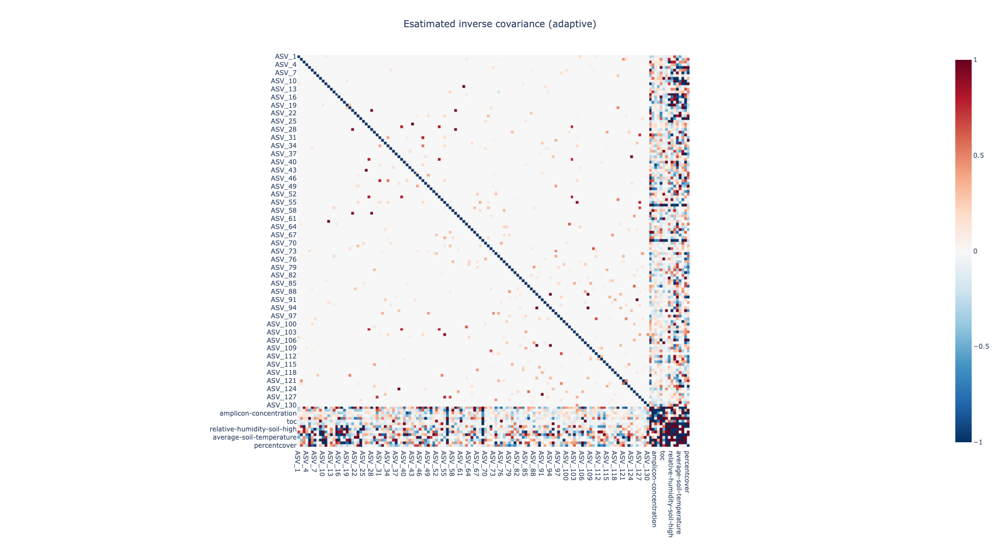

In [42]:
precision_adapt = pd.DataFrame(P_SGL_adapt.solution.precision_, columns=vis_df.columns, index=vis_df.columns)

fig = px.imshow(-1*precision_adapt, color_continuous_scale='RdBu_r', zmin=-1, zmax=1)
fig.update_layout(margin = dict(t=100,r=100,b=100,l=100), width = 1000, height = 1000,
                 title='Esatimated inverse covariance (adaptive)', title_x=0.5)
# fig.write_image("plots/sgl_asv_and_cov.png")

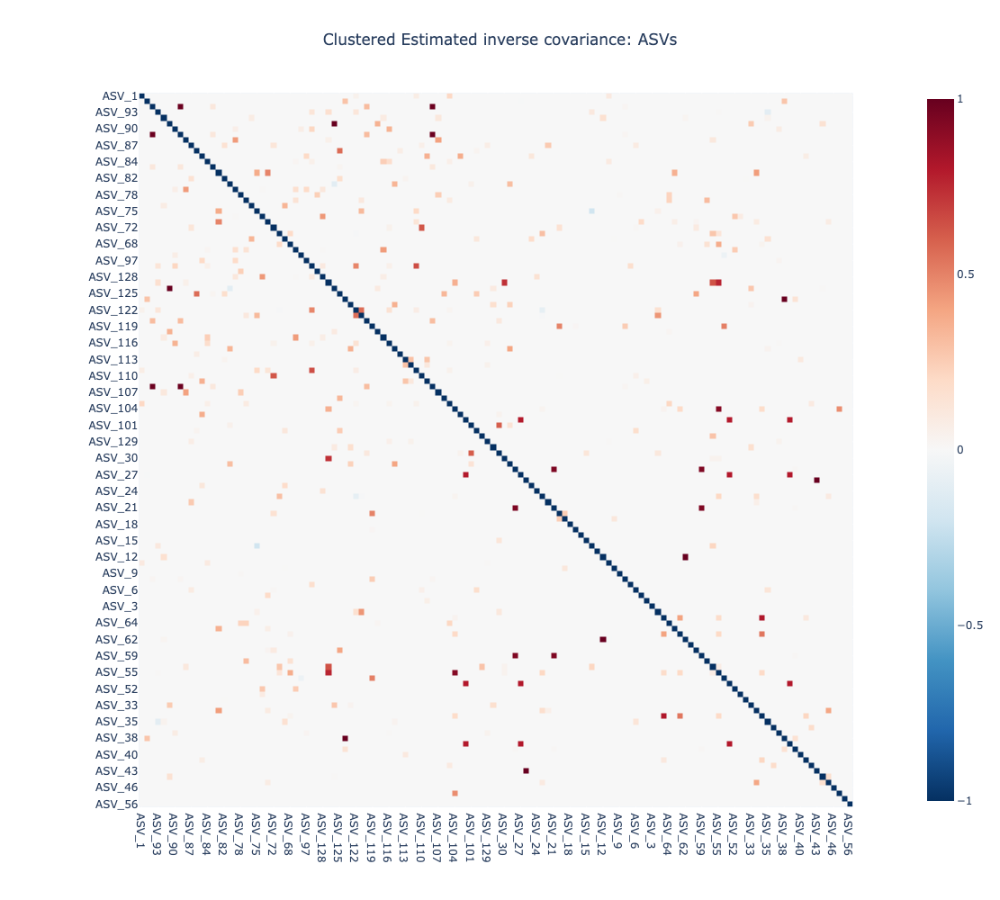

In [53]:
fig = px.imshow(-1*cluster_corr(precision_adapt.iloc[:-n_cov, :-n_cov]), color_continuous_scale='RdBu_r', zmin=-1, zmax=1)
fig.update_layout(margin = dict(t=100,r=100,b=100,l=100), width = 1000, height = 1000,
                 title='Clustered Estimated inverse covariance: ASVs', title_x=0.5)

In [54]:
adapt_theta = precision_adapt.copy()

asv_cov = adapt_theta.iloc[:-n_cov, -n_cov:]

l1_norm = np.linalg.norm(asv_cov.values, axis=1)

adapt_theta['l1'] = np.append(l1_norm, np.zeros(n_cov))

In [55]:
test = adapt_theta.T
test['l1'] = np.append(l1_norm, np.zeros(n_cov+1))
test.shape

(146, 146)

In [56]:
test_1 = test.sort_values(by=['l1'], ascending=False)
test_2 = test_1.T
test_3 = test_2.sort_values(by=['l1'], ascending=False)
test_3

,ASV_56,ASV_69,ASV_17,ASV_61,ASV_5,ASV_24,ASV_15,ASV_123,ASV_48,ASV_10,...,relative-humidity-soil-low,amplicon-concentration,average-soil-relative-humidity,ec,toc,ph,depth,extract-concen,elevation,l1
ASV_56,16.738994,-0.000000,0.000000,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000,...,0.962381,0.780114,-0.102304,1.455440,1.060386,-1.558797,0.651099,2.004937,-11.433242,18.143818
ASV_69,-0.000000,16.136514,0.000000,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000,...,0.974076,0.624635,-0.080576,1.443386,0.985745,-1.518488,0.594703,1.682697,-10.863897,17.411740
ASV_17,0.000000,0.000000,3.269010,-0.000000,0.000000,0.000000,0.000000,-0.000000,-0.000000,-0.000000,...,-0.896361,0.344358,1.384782,0.027244,0.170023,0.624883,-0.027464,0.007673,6.244759,8.749974
ASV_61,-0.000000,-0.000000,-0.000000,8.155652,-0.000000,0.000000,-0.000000,-0.000000,-0.000000,-0.000000,...,0.314550,-0.507894,0.128979,0.167756,-7.748208,0.738559,0.062031,0.906674,0.387330,7.893439
ASV_5,-0.000000,-0.000000,0.000000,-0.000000,3.312990,-0.000000,-0.000000,-0.000000,-0.000000,0.000000,...,0.039364,-0.166790,-0.497756,0.542542,0.208545,-0.986382,-0.010080,0.527248,-0.019532,4.798626
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ph,-1.558797,-1.518488,0.624883,0.738559,-0.986382,-0.618429,0.039920,-0.550620,1.077228,-0.225588,...,6.195222,-0.012220,-0.010812,-1.740009,-1.173876,13.169860,-1.222897,1.596066,1.838533,0.000000
depth,0.651099,0.594703,-0.027464,0.062031,-0.010080,0.187661,-0.164751,-0.122581,0.057093,-0.104394,...,-0.289969,0.600895,0.000000,-0.340326,0.702997,-1.222897,4.190177,1.174288,-0.567333,0.000000
extract-concen,2.004937,1.682697,0.007673,0.906674,0.527248,0.366462,0.149826,-0.135512,0.176503,0.027108,...,-0.692362,1.166345,0.000000,-0.160338,1.271333,1.596066,1.174288,8.656985,-3.187556,0.000000
elevation,-11.433242,-10.863897,6.244759,0.387330,-0.019532,-2.480406,-1.607926,-0.027912,2.936645,-0.048306,...,-0.000000,0.000000,-2.489786,1.773099,-2.666093,1.838533,-0.567333,-3.187556,90.153512,0.000000


In [57]:
test = adapt_theta.sort_values(by=['l1'], ascending=False)
# test_2 = test.T.sort_values(by=['l1'], ascending=False)

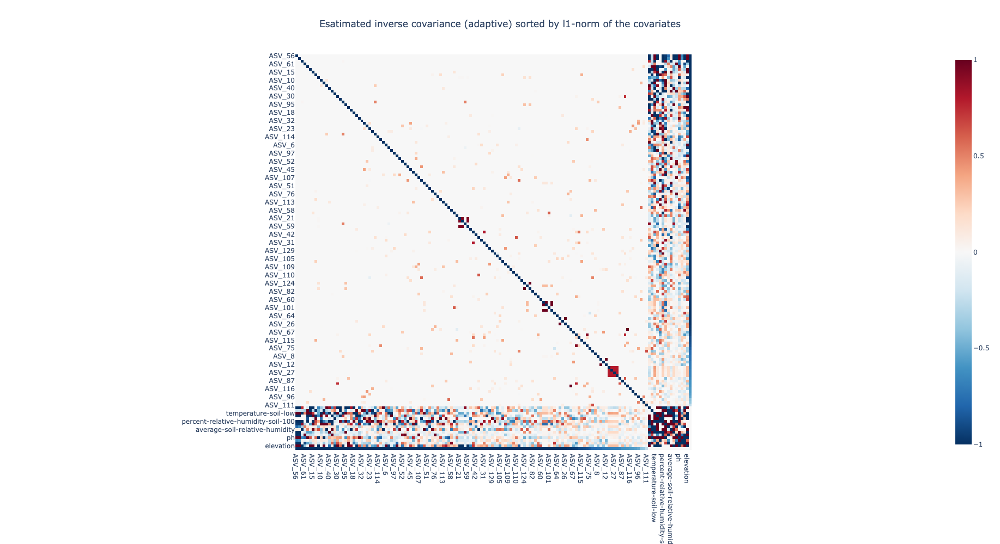

In [58]:
fig = px.imshow(-1*test_3, color_continuous_scale='RdBu_r', zmin=-1, zmax=1)
fig.update_layout(margin = dict(t=100,r=100,b=100,l=100), width = 1000, height = 1000,
                 title='Esatimated inverse covariance (adaptive) sorted by l1-norm of the covariates', title_x=0.5)

In [239]:
def create_graph(corr_matrix: pd.DataFrame()):
    #take the upper part only
    upper = np.triu(np.ones(corr_matrix.shape)).astype(bool)
    df = corr_matrix.where(upper)
    df = pd.DataFrame(corr_matrix.stack(), columns=['covariance']).reset_index()
    df.columns = ["taxa_y", "taxa_x", "covariance"]
    
    #remove diagonal entries
    df = df[df['taxa_x'] != df['taxa_y']]
    #remove zero entries
    df = df[df['covariance'] != 0]
    #build graph
    G = nx.from_pandas_edgelist(df,  "taxa_y", "taxa_x", "covariance")
    
    return G

In [240]:
G_SGL = create_graph(precision_SGL)
G_adapt = create_graph(precision_adapt)
G_low = create_graph(precision_SGL_low)

In [241]:
def plot_network(G, title):
    #Establish which categories will appear when hovering over each node
    HOVER_TOOLTIPS = [("Character", "@index")]
    hover = HoverTool(tooltips=[('','@index')])
    tools = ["save, zoom_in, zoom_out, wheel_zoom, box_zoom, crosshair, reset, hover"]

    #Create a plot — set dimensions, toolbar, and title
    plot = figure(tooltips = HOVER_TOOLTIPS,
                  tools=tools, active_scroll='wheel_zoom',
                x_range=Range1d(-10.1, 10.1), 
                  y_range=Range1d(-10.1, 10.1), title=title)

    #Create a network graph object with spring layout
    # https://networkx.github.io/documentation/networkx-1.9/reference/generated/networkx.drawing.layout.spring_layout.html
    network_graph = from_networkx(G, nx.spring_layout, scale=10, center=(0, 0))

    #Set node size and color
    network_graph.node_renderer.glyph = Circle(size=20, fill_color='skyblue')

    #Set edge opacity and width
    network_graph.edge_renderer.glyph = MultiLine(line_alpha=0.5, line_width=1)

    #Add network graph to the plot
    plot.renderers.append(network_graph)
    
    x, y = zip(*network_graph.layout_provider.graph_layout.values())
    node_labels = list(G.nodes)
    source = ColumnDataSource({'x': x, 'y': y, 'asv': [node_labels[i] for i in range(len(x))]})
    labels = LabelSet(x='x', y='y', text='asv', source=source, render_mode='canvas',
                     text_font_size='1vh')

    plot.renderers.append(labels)

    return plot

In [242]:
p1 = plot_network(G_SGL, title="SGL")
p2 = plot_network(G_adapt, title="Adaptive")
p3 = plot_network(G_low, title="Low-rank")

Add covariance filter on edges

In [245]:
show(p3)

In [71]:
from gglasso.helper.basic_linalg import adjacency_matrix

sparse_SGL = precision_SGL.values
A_SGL = adjacency_matrix(sparse_SGL)
G_SGL = nx.from_numpy_array(A_SGL)
pos_SGL = nx.drawing.layout.spring_layout(G_SGL, seed = 1234)

rcm_SGL = list(cuthill_mckee_ordering(G_SGL))
d_SGL = {node:rcm_SGL.index(node) for node in G_SGL}
H_SGL = nx.relabel_nodes(G_SGL, mapping=d_SGL)
H_adj_SGL = nx.adjacency_matrix(H_SGL,nodelist=range(53))


sparse_adapt = precision_adapt.iloc[:-n_cov, :-n_cov].values
A_adapt = adjacency_matrix(sparse_adapt)
G_adapt = nx.from_numpy_array(A_adapt)
pos_adapt = nx.drawing.layout.spring_layout(G_adapt, seed = 1234)

rcm_adapt = list(cuthill_mckee_ordering(G_adapt))
d_adapt = {node:rcm_adapt.index(node) for node in G_adapt}
H_adapt = nx.relabel_nodes(G_adapt, mapping=d_SGL)
H_adj_adapt = nx.adjacency_matrix(H_adapt, nodelist=range(53))

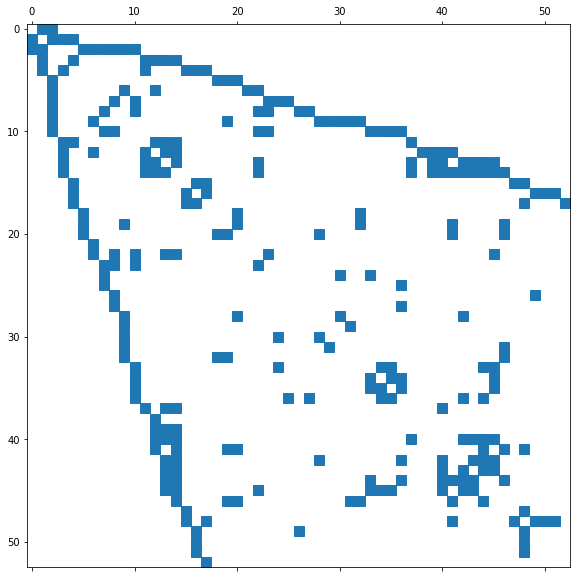

In [497]:
fig = plt.figure(figsize=(10,10))
plt.spy(H_adj_SGL)
# plt.xticks(range(10), range(1, 11))
# plt.yticks(range(10), range(1, 11))
# fig.savefig('plots/cuthil_SGL.png', dpi=fig.dpi)

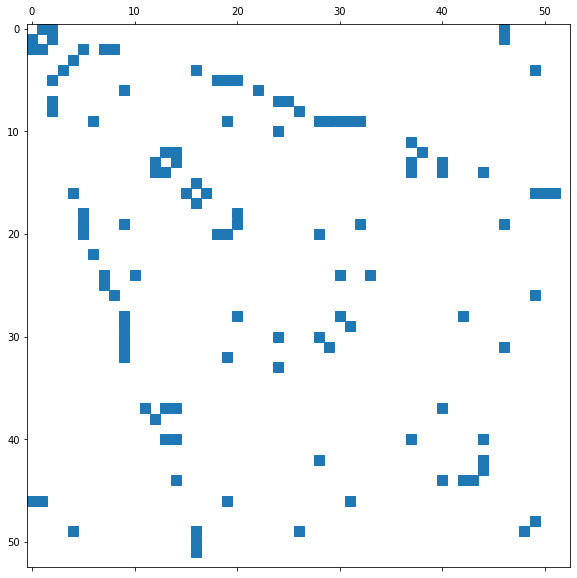

In [499]:
fig = plt.figure(figsize=(10,10))
plt.spy(H_adj_adapt)
# fig.savefig('plots/cuthil_adaptive.png', dpi=fig.dpi)

In [448]:
# fig, axs = plt.subplots(1,2, figsize=(50,50))
# nx.draw_networkx(G_SGL, pos = pos_SGL, node_size = node_size, node_color = "darkblue", edge_color = "darkblue", \
#                  font_size = font_size, font_color = 'white', with_labels = True, ax = axs[0,0])
# axs[0,0].axis('off')
# axs[0,0].set_title("SGL graph")

# nx.draw_networkx(G_adapt, pos = pos_adapt, node_size = node_size, node_color = "peru", edge_color = "peru", \
#                font_size = font_size, font_color = 'white', with_labels = True, ax = axs[0,1])
# axs[0,1].axis('off')
# axs[0,1].set_title("Adaptive SGL graph")

# sns.heatmap(sparse_SGL, cmap = "coolwarm", vmin = -0.5, vmax = 0.5, linewidth = .5, square = True, cbar = False, \
#             xticklabels = [], yticklabels = [], ax = axs[1,0])
# axs[1,0].set_title("SGL")

# sns.heatmap(sparse_adapt, cmap = "coolwarm", vmin = -0.5, vmax = 0.5, linewidth = .5, square = True, cbar = False, \
#             xticklabels = [], yticklabels = [], ax = axs[1,1])
# axs[1,1].set_title("Adaptive SGL")

# fig.savefig('plots/network_1.png', dpi=fig.dpi)

In [268]:
P_SGL_adapt_2 = glasso_problem(vis_S_meta_2.values, N_meta, latent=False, do_scaling=False)
print(P_SGL_adapt_2)

 
SINGLE GRAPHICAL LASSO PROBLEM 
Regularization parameters:
{'lambda1': None, 'mu1': None}


In [269]:
P_SGL_adapt_2.model_selection(modelselect_params=modelselect_params, method='eBIC', gamma=0.1)
print(P_SGL_adapt_2.reg_params)

ADMM terminated after 1000 iterations with status: primal optimal.
ADMM terminated after 1000 iterations with status: primal optimal.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: primal optimal.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status

In [270]:
for stat in ['AIC', 'SP', 'LAMBDA', 'BEST']:
    print(stat)
    print(P_SGL_adapt_2.modelselect_stats[stat])

AIC
[[  6502.4440776 ]
 [  5497.71358167]
 [  3175.79234963]
 [  1423.82533785]
 [  -324.45810206]
 [ -2264.53125775]
 [ -4353.03787771]
 [ -6743.52975969]
 [ -9262.40149426]
 [-11661.975947  ]
 [-14072.19660861]
 [-15859.42787654]
 [-17593.22410208]
 [-19334.28732842]
 [-21066.47078349]]
SP
[[0.1506705 ]
 [0.175     ]
 [0.21005747]
 [0.27758621]
 [0.36570881]
 [0.44837165]
 [0.53065134]
 [0.58802682]
 [0.62950192]
 [0.66752874]
 [0.69597701]
 [0.73189655]
 [0.76618774]
 [0.7960728 ]
 [0.82193487]]
LAMBDA
[[1.00000000e+00]
 [5.17947468e-01]
 [2.68269580e-01]
 [1.38949549e-01]
 [7.19685673e-02]
 [3.72759372e-02]
 [1.93069773e-02]
 [1.00000000e-02]
 [5.17947468e-03]
 [2.68269580e-03]
 [1.38949549e-03]
 [7.19685673e-04]
 [3.72759372e-04]
 [1.93069773e-04]
 [1.00000000e-04]]
BEST
{'lambda1': 0.2682695795279726, 'mu1': 0}


In [271]:
precision_adapt_2 = pd.DataFrame(P_SGL_adapt_2.solution.precision_, columns=vis_df.columns, index=vis_df.columns)

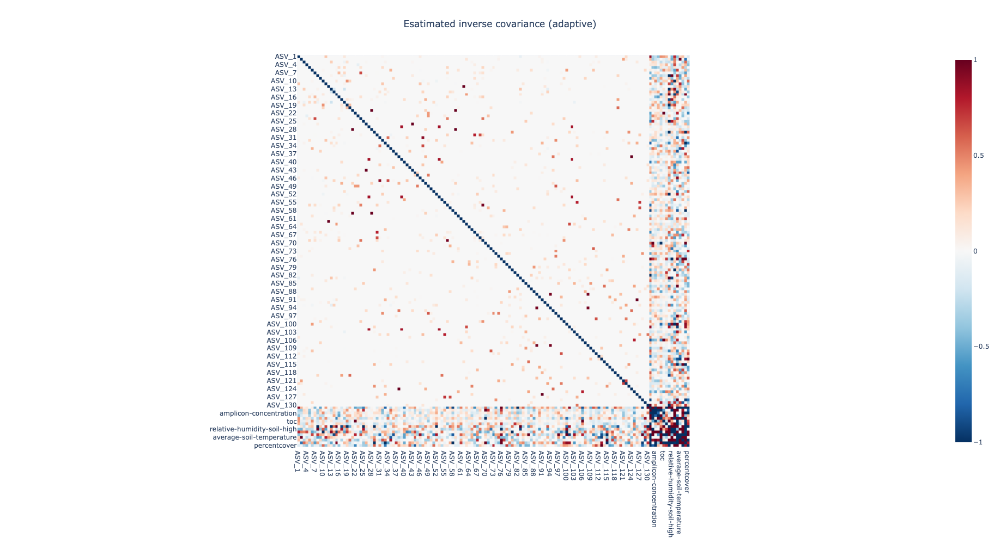

In [272]:
fig = px.imshow(-1*precision_adapt_2, color_continuous_scale='RdBu_r', zmin=-1, zmax=1)
fig.update_layout(margin = dict(t=100,r=100,b=100,l=100), width = 1000, height = 1000,
                 title='Esatimated inverse covariance (adaptive)', title_x=0.5)

In [273]:
P_SGL_adapt_3 = glasso_problem(vis_S_meta_3.values, N_meta, latent=False, do_scaling=False)
print(P_SGL_adapt_3)

 
SINGLE GRAPHICAL LASSO PROBLEM 
Regularization parameters:
{'lambda1': None, 'mu1': None}


In [274]:
P_SGL_adapt_3.model_selection(modelselect_params=modelselect_params, method='eBIC', gamma=0.1)
print(P_SGL_adapt_3.reg_params)

ADMM terminated after 1000 iterations with status: primal optimal.
ADMM terminated after 1000 iterations with status: primal optimal.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: primal optimal.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: primal optimal.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: primal optimal.
ADMM terminated after 1000 iterations with status: max iterations reached.
ADMM terminated after 1000 iterations with status: max iterations

In [275]:
for stat in ['AIC', 'SP', 'LAMBDA', 'BEST']:
    print(stat)
    print(P_SGL_adapt_3.modelselect_stats[stat])

AIC
[[  6023.62184321]
 [  5408.80151071]
 [  3144.96100107]
 [  1304.30860177]
 [  -401.72667512]
 [ -2270.82014138]
 [ -4491.08221324]
 [ -6881.839235  ]
 [ -9386.91233675]
 [-11782.57598143]
 [-14150.50846976]
 [-15810.16425905]
 [-17642.66084433]
 [-19476.65014106]
 [-21149.78037728]]
SP
[[0.14568966]
 [0.17270115]
 [0.21091954]
 [0.27691571]
 [0.37059387]
 [0.4612069 ]
 [0.53199234]
 [0.58831418]
 [0.63180077]
 [0.67126437]
 [0.70124521]
 [0.73917625]
 [0.76944444]
 [0.79415709]
 [0.82528736]]
LAMBDA
[[1.00000000e+00]
 [5.17947468e-01]
 [2.68269580e-01]
 [1.38949549e-01]
 [7.19685673e-02]
 [3.72759372e-02]
 [1.93069773e-02]
 [1.00000000e-02]
 [5.17947468e-03]
 [2.68269580e-03]
 [1.38949549e-03]
 [7.19685673e-04]
 [3.72759372e-04]
 [1.93069773e-04]
 [1.00000000e-04]]
BEST
{'lambda1': 0.2682695795279726, 'mu1': 0}


In [276]:
precision_adapt_3 = pd.DataFrame(P_SGL_adapt_3.solution.precision_, columns=vis_df.columns, index=vis_df.columns)

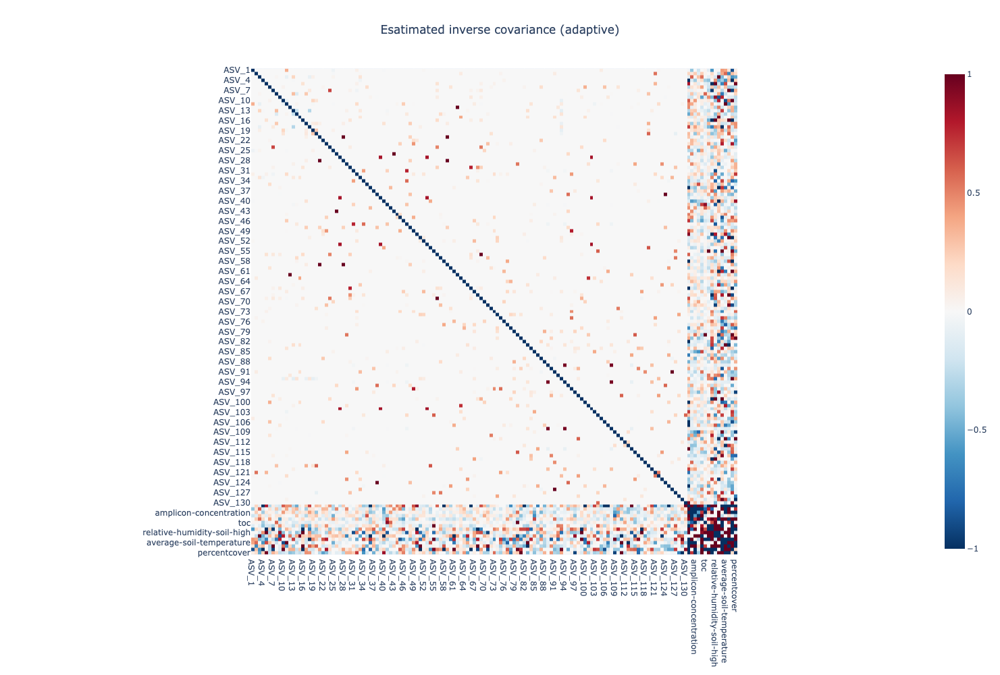

In [277]:
fig = px.imshow(-1*precision_adapt_3, color_continuous_scale='RdBu_r', zmin=-1, zmax=1)
fig.update_layout(margin = dict(t=100,r=100,b=100,l=100), width = 1000, height = 1000,
                 title='Esatimated inverse covariance (adaptive)', title_x=0.5)

In [288]:
print("Number of zeros in Theta_1: {0}".format((precision_adapt.iloc[:-n_cov, :-n_cov] == 0).astype(int).sum(axis=1).sum()))
print("Number of zeros in Theta_2: {0}".format((precision_adapt_2.iloc[:-n_cov, :-n_cov] == 0).astype(int).sum(axis=1).sum()))
print("Number of zeros in Theta_3: {0}".format((precision_adapt_3.iloc[:-n_cov, :-n_cov] == 0).astype(int).sum(axis=1).sum()))

Number of zeros in Theta_1: 16294
Number of zeros in Theta_2: 15958
Number of zeros in Theta_3: 15988


# Compare how similar inverse parts of the solution

In [40]:
S_1 = precision_adapt.iloc[:-15, :-15]

In [41]:
S_2 = precision_SGL_low != 0

In [42]:
S_0 = precision_SGL != 0

In [43]:
print((S_1 + S_2).astype(bool).values.sum())
print((S_1 + S_0).astype(bool).values.sum())
print((S_2 + S_0).astype(bool).values.sum())

926
1126
1104


/Users/oleg.vlasovetc/opt/anaconda3/lib/python3.8/site-packages/pandas/core/computation/expressions.py:203: UserWarning:

evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead



There are more Falses in first case which means less dissagreement between adaptive and low-rank solutions

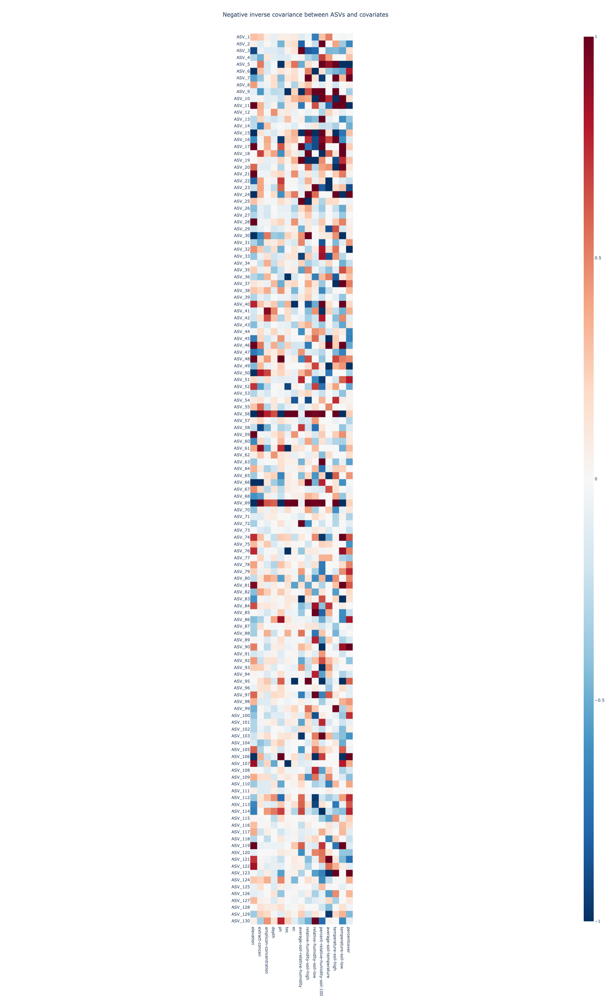

In [51]:
inv_cov = precision_adapt.iloc[:-n_cov, -n_cov:]

fig = px.imshow(inv_cov, color_continuous_scale='RdBu_r', zmin=-1, zmax=1)
fig.update_layout(margin = dict(t=100,r=100,b=100,l=100), width = 600, height = 3000,
                 title='Negative inverse covariance between ASVs and covariates', title_x=0.5)

# fig.write_image("plots/sgl_cov.png")

# LOW RANKS

In [55]:
L_adapt = inv_cov @ inv_cov.T
L_adapt.shape

(130, 130)

In [62]:
L_1 = pd.DataFrame(P_SGL_low.solution.lowrank_, columns=asv_names, index=asv_names)
L_2 = pd.DataFrame(L_adapt, columns=asv_names, index=asv_names)

print("L1-rank: {0}".format(np.linalg.matrix_rank(L_1)))
print("L2-rank: {0}".format(np.linalg.matrix_rank(L_2)))

L1-rank: 6
L2-rank: 15


In [69]:
proj_1, loadings_1, eigv_1 = PCA(asv, L_1, inverse=True)

eigv_sum_1 = np.sum(eigv_1)
var_exp_1 = [(value / eigv_sum_1) for value in sorted(eigv_1, reverse=True)]

proj_2, loadings_2, eigv_2 = PCA(asv, L_2, inverse=True)

eigv_sum_2 = np.sum(eigv_2)
var_exp_2 = [(value / eigv_sum_2) for value in sorted(eigv_2, reverse=True)]

In [486]:
proj_1.shape

(53, 6)

In [ ]:
x = raw_data.sum(axis=0)
seq_depth = pd.DataFrame(data=x, columns=["sequencing depth"])

df = transformed_data.join(seq_depth)

for col in meta.columns:

    for i in range(0, rank):

        x = loadings[:,i]
        y = inv_cov[col]

        r_2 = stats.spearmanr(x, y)[0]
        p_value = stats.spearmanr(x, y)[1]
        title_1 = "Spearman correlation {0}".format(np.round(r_2, 3))

        # Find the slope and intercept of the best fit line
        slope, intercept = np.polyfit(x, y, 1)

        # Create a list of values in the best fit line
        abline_values = [slope * i + intercept for i in x]

        fig, ax = plt.subplots(nrows = 1, ncols = 2, sharex=False, sharey = False, squeeze=False, figsize=(15, 7))
        ax[0][0].scatter(x, y)
        ax[0][0].plot(x, abline_values, 'b')
        ax[0][0].set_xlabel("Principal axis (loading vector) {0}".format(i+1))
        ax[0][0].set_ylabel("estimated {0}".format(col))
        ax[0][0].title.set_text(title_1)

        yabs_max = abs(max(ax[0][0].get_ylim(), key=abs))
        xabs_max = abs(max(ax[0][0].get_xlim(), key=abs))
        ax[0][0].set_ylim(ymin=-yabs_max, ymax=yabs_max)
        ax[0][0].set_xlim(xmin=-xabs_max, xmax=xabs_max)

        spearman_corr = stats.spearmanr(df[col], proj[:, i])[0]
        p_value = stats.spearmanr(df[col], proj[:, i])[1]

        title_2 = "Spearman correlation {0}".format(np.round(spearman_corr, 3))
        im = ax[0][1].scatter(proj[:, i], df[col], c=df['sequencing depth'], cmap=plt.cm.Blues, vmin=0)
        cbar = fig.colorbar(im)


        cbar.set_label("Sampling depth")
        ax[0][1].set_xlabel("PC{0} ({1}%)".format(i + 1, str(100 * var_exp[i])[:4]))
        ax[0][1].set_ylabel("{0}".format(col))
        ax[0][1].title.set_text(title_2)

        plt.show()
#         plt.savefig("plots/pc_plots/scatter_pc_{0}_{1}.png".format(i, col))

In [72]:
depth = raw.sum(axis=0)

In [461]:
cols = df.iloc[:, -n_cov:].columns
cols

Index(['elevation', 'extract-concen', 'amplicon-concentration', 'depth', 'ph',
       'toc', 'ec', 'average-soil-relative-humidity',
       'relative-humidity-soil-high', 'relative-humidity-soil-low',
       'percent-relative-humidity-soil-100', 'average-soil-temperature',
       'temperature-soil-high', 'temperature-soil-low', 'percentcover'],
      dtype='object')

In [458]:
col = 'average-soil-temperature'

In [474]:
for j in range(0, proj_2.shape[1]):
    for i in cols:
        r = stats.spearmanr(df[i], proj_2[:,j])[0]
        if r > 0.6:
            print(i)
            print(j)

temperature-soil-high
6
amplicon-concentration
12
depth
13
ph
14
average-soil-temperature
14
temperature-soil-high
14
temperature-soil-low
14


In [475]:
for j in range(0, proj_1.shape[1]):
    for i in cols:
        r = stats.spearmanr(df[i], proj_1[:,j])[0]
        if r > 0.6:
            print(i)
            print(j)

average-soil-temperature
0
temperature-soil-high
0
temperature-soil-low
0


Spearman correlation between Average soil temperature and 14 component: 0.8339993002569336, p-value: 8.929432170710365e-15


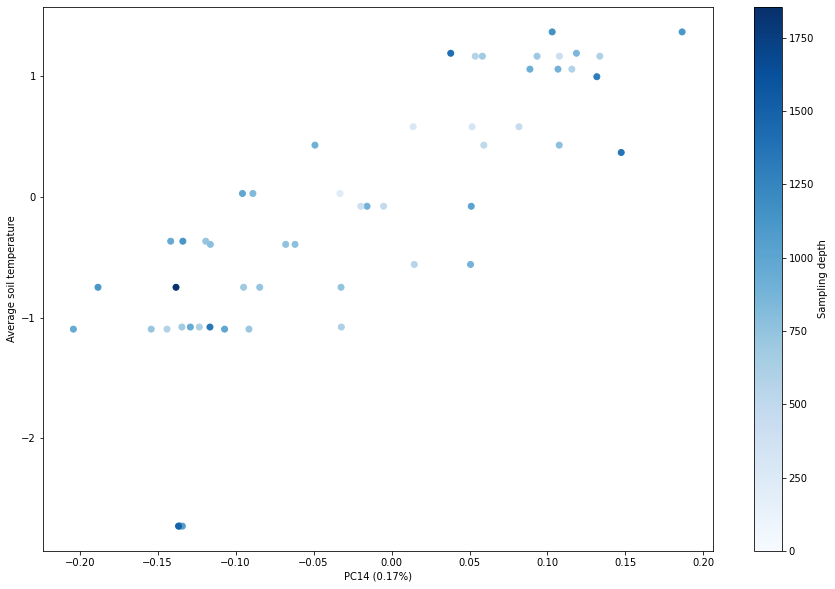

In [481]:
fig, ax = plt.subplots(1,1, figsize=(15, 10))
im = ax.scatter(proj_2[:,14], df['average-soil-temperature'], c = depth, cmap = plt.cm.Blues, vmin = 0)
cbar = fig.colorbar(im)
cbar.set_label("Sampling depth")
ax.set_xlabel("PC{0} ({1}%)".format(14, str(100 * var_exp_2[14])[:4]))
ax.set_ylabel('Average soil temperature')

print("Spearman correlation between Average soil temperature and 14 component: {0}, p-value: {1}".format(stats.spearmanr(df['average-soil-temperature'], proj_2[:,14])[0],
                                                                              stats.spearmanr(df['average-soil-temperature'], proj_2[:,14])[1]))

Spearman correlation between Average soil temperature and 1 component: 0.7323157259476466, p-value: 4.6118253268441833e-10


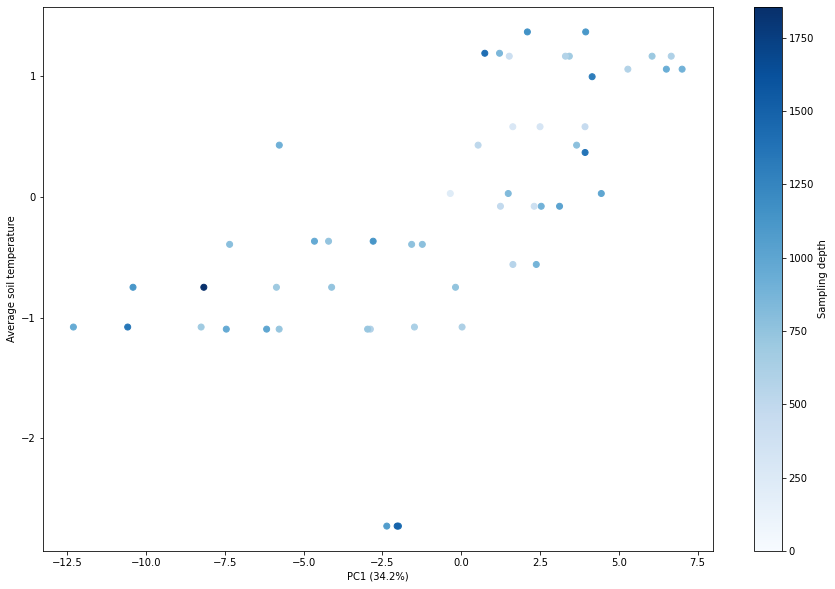

In [482]:
fig, ax = plt.subplots(1,1, figsize=(15, 10))
im = ax.scatter(proj_1[:,0], df['average-soil-temperature'], c = depth, cmap = plt.cm.Blues, vmin = 0)
cbar = fig.colorbar(im)
cbar.set_label("Sampling depth")
ax.set_xlabel("PC{0} ({1}%)".format(1, str(100 * var_exp_1[0])[:4]))
ax.set_ylabel('Average soil temperature')

print("Spearman correlation between Average soil temperature and 1 component: {0}, p-value: {1}".format(stats.spearmanr(df['average-soil-temperature'], proj_1[:,0])[0],
                                                                              stats.spearmanr(df['average-soil-temperature'], proj_1[:,0])[1]))

**Statement 5**:

Now we would like to test if the latent components of our solution can explain the covariates.

On the left-hand subplot, we project estimated covariates to the low-rank solution.
On the right-hand subplot, we project original covariates to the same low-rank solution where no covariates were included.

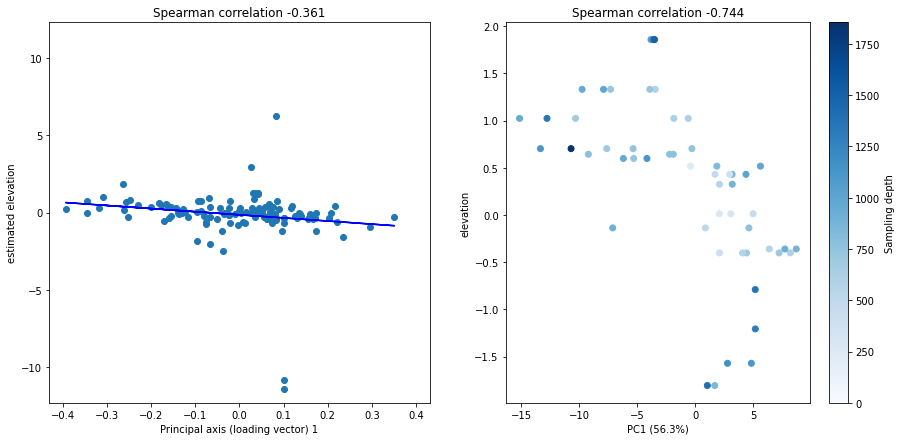

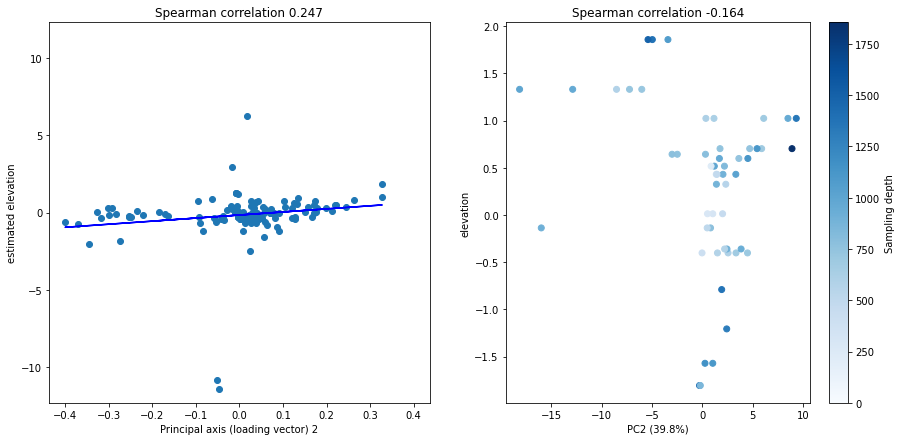

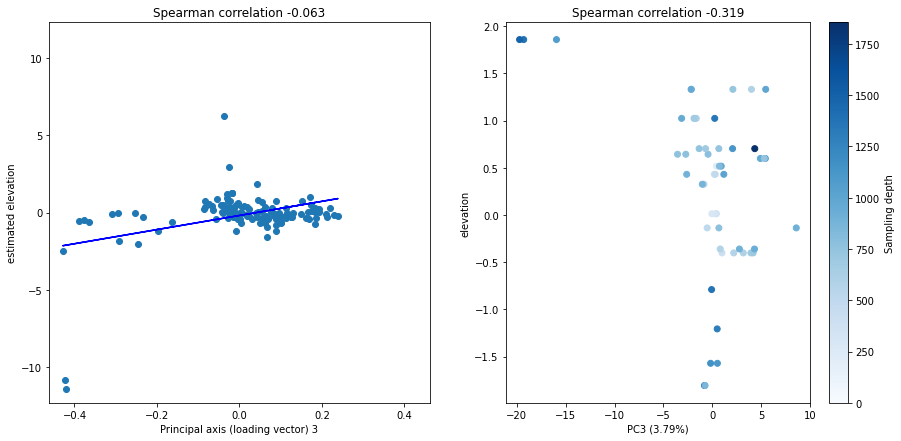

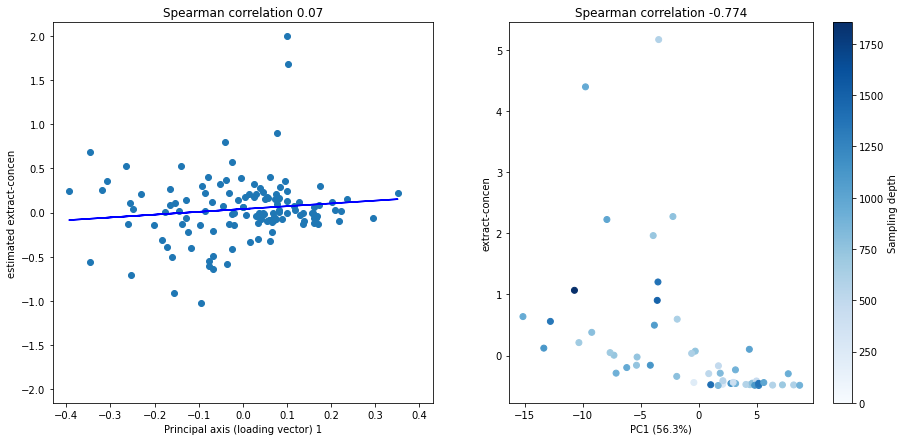

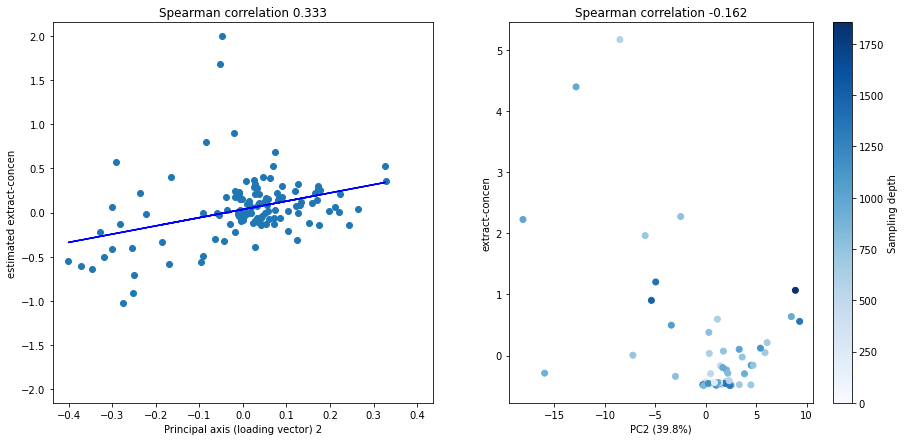

...

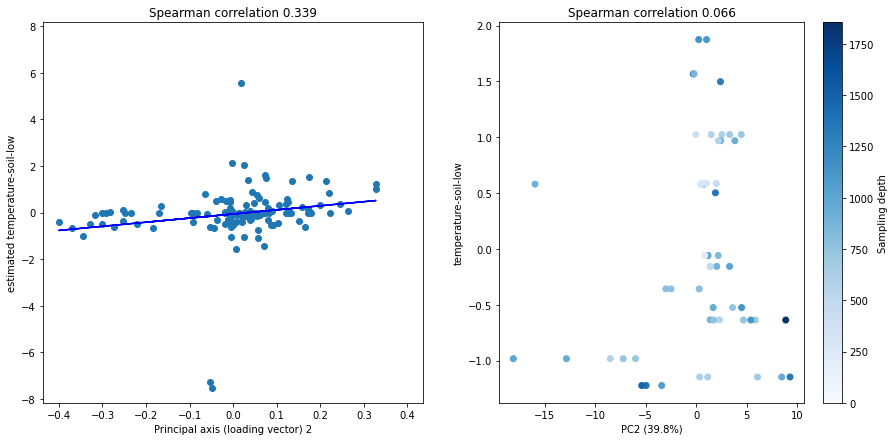

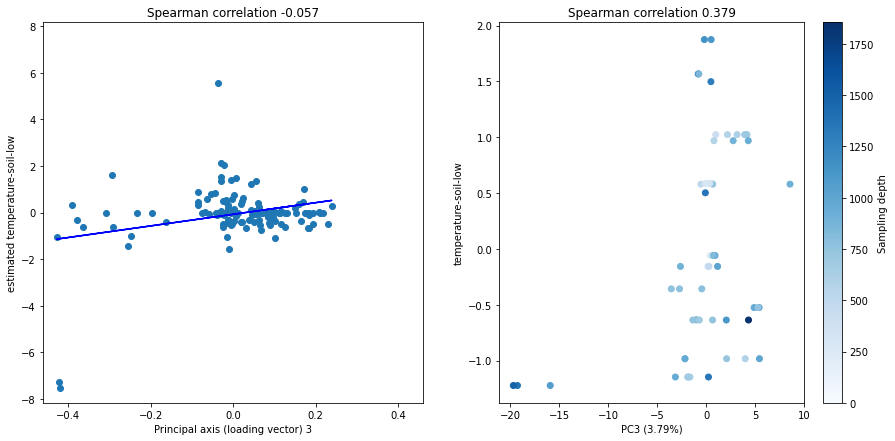

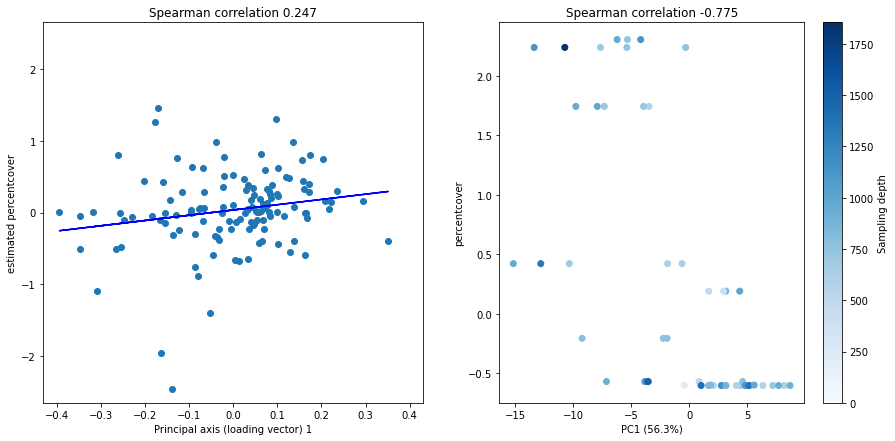

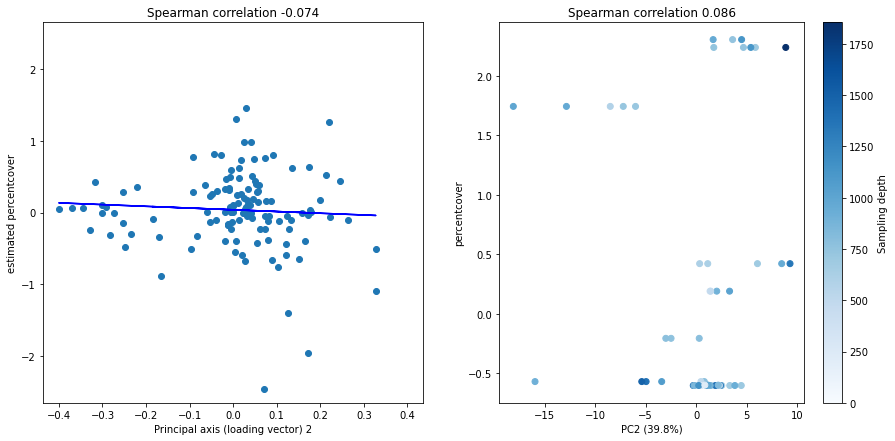

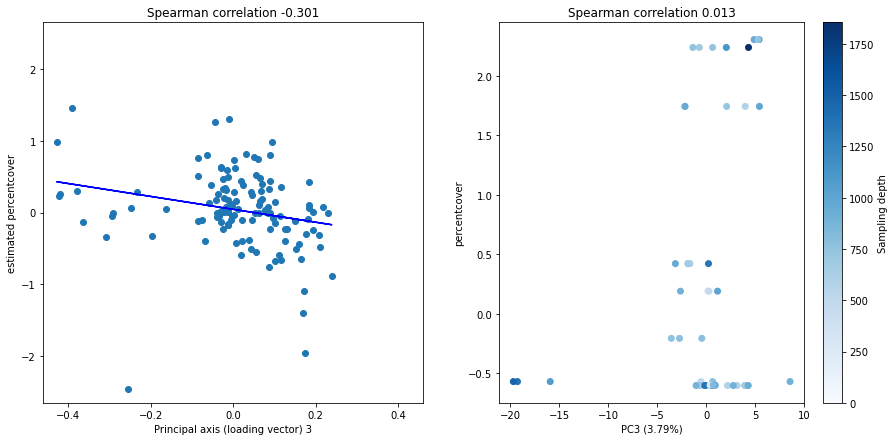

In [226]:
# plot PCs vs covariates



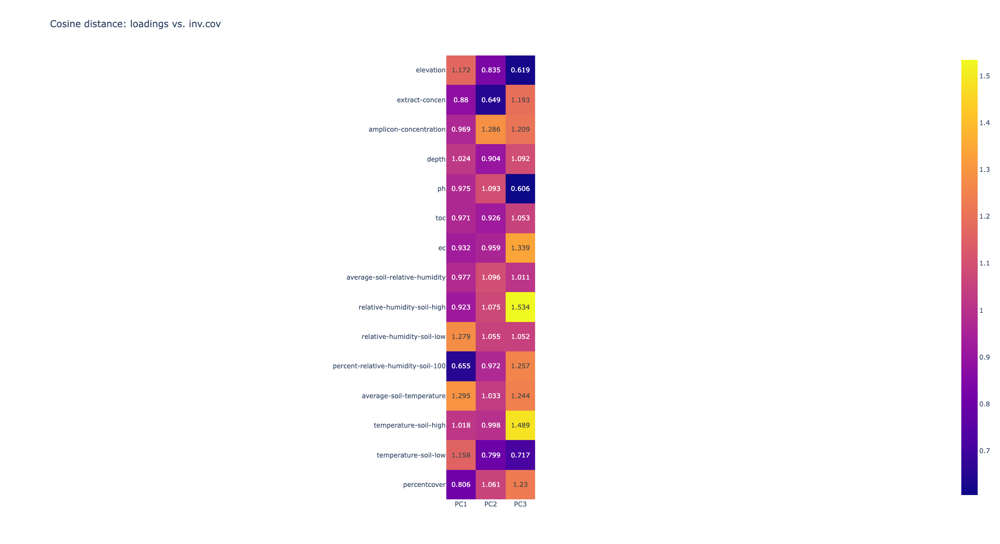

In [188]:
x = loadings
y = inv_cov

cosine_dict = dict()

for i in range(0, x.shape[1]):
    for j in range(0, y.shape[1]):
        cosine_dict[i, y.columns[j]] = round(distance.cosine(x[:,i],  y.iloc[:, j]), 3)
        
        
a = pd.Series(cosine_dict)

b = pd.DataFrame({"PC1": a[0], "PC2": a[1], "PC3": a[2]})

fig = px.imshow(b, text_auto=True,
               title="Cosine distance: loadings vs. inv.cov")
fig.layout.height = 1000
fig.layout.width = 500

fig.show()
fig.write_image("plots/cosine_dist.png")

In [239]:
# inv_cov

round(distance.cosine(inv_cov['elevation'],  inv_cov['ph']), 3)

0.5

In [243]:
import itertools

docs_combinations = itertools.combinations(inv_cov.columns, 2)

for doc1, doc2 in docs_combinations:
    round(distance.cosine(inv_cov['elevation'],  inv_cov['ph']), 3)
    print(doc1,doc2)

elevation extract-concen
elevation amplicon-concentration
elevation depth
elevation ph
elevation toc
elevation ec
elevation average-soil-relative-humidity
elevation relative-humidity-soil-high
elevation relative-humidity-soil-low
elevation percent-relative-humidity-soil-100
elevation average-soil-temperature
elevation temperature-soil-high
elevation temperature-soil-low
elevation percentcover
extract-concen amplicon-concentration
extract-concen depth
extract-concen ph
extract-concen toc
extract-concen ec
extract-concen average-soil-relative-humidity
extract-concen relative-humidity-soil-high
extract-concen relative-humidity-soil-low
extract-concen percent-relative-humidity-soil-100
extract-concen average-soil-temperature
extract-concen temperature-soil-high
extract-concen temperature-soil-low
extract-concen percentcover
amplicon-concentration depth
amplicon-concentration ph
amplicon-concentration toc
amplicon-concentration ec
amplicon-concentration average-soil-relative-humidity
amplic

In [139]:
# proj, loadings, eigv = PCA(asv, L_tuned, inverse=True)
proj, loadings, eigv = PCA(asv, L, inverse=True)

In [140]:
depth = raw.sum(axis=0)
ph = vis_df["ph"]

Spearman correlation between pH and 1st component: 0.566576784474541, p-value: 9.758331973188197e-06


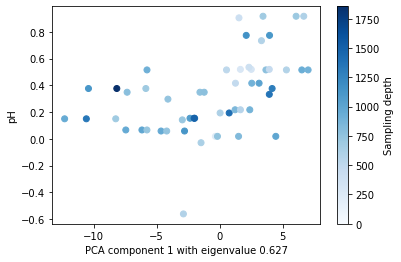

In [141]:
fig, ax = plt.subplots(1,1)
im = ax.scatter(proj[:,0], ph, c = depth, cmap = plt.cm.Blues, vmin = 0)
cbar = fig.colorbar(im)
cbar.set_label("Sampling depth")
ax.set_xlabel(f"PCA component 1 with eigenvalue {eigv[0]}")
ax.set_ylabel("pH")

print("Spearman correlation between pH and 1st component: {0}, p-value: {1}".format(stats.spearmanr(ph, proj[:,0])[0],
                                                                              stats.spearmanr(ph, proj[:,0])[1]))


In [212]:
from scipy.spatial import distance
import plotly.express as px

x = loadings
y = inv_cov

cosine_dict = dict()

for i in range(0, y.shape[1]):
    for j in range(0, y.shape[1]):
        cosine_dict[i, j] = round(distance.cosine(y.iloc[:, j],  y.iloc[:, j]), 3)
        
cosine_dict
        
# a = pd.Series(cosine_dict)

# a
# b = pd.DataFrame(a)

# fig = px.imshow(a, text_auto=True,
#                title="Cosine distance: loadings vs. inv.cov")
# fig.layout.height = 1000
# fig.layout.width = 500

# fig.show()
# fig.write_image("plots/cosine_dist.png")

{(0, 0): 0,
 (0, 1): 0,
 (0, 2): 0,
 (0, 3): 0,
 (0, 4): 0,
 (0, 5): 0,
 (0, 6): 0,
 (0, 7): 0,
 (0, 8): 0,
 (0, 9): 0,
 (0, 10): 0,
 (0, 11): 0,
 (0, 12): 0,
 (0, 13): 0,
 (0, 14): 0,
 (1, 0): 0,
 (1, 1): 0,
 (1, 2): 0,
 (1, 3): 0,
 (1, 4): 0,
 (1, 5): 0,
 (1, 6): 0,
 (1, 7): 0,
 (1, 8): 0,
 (1, 9): 0,
 (1, 10): 0,
 (1, 11): 0,
 (1, 12): 0,
 (1, 13): 0,
 (1, 14): 0,
 (2, 0): 0,
 (2, 1): 0,
 (2, 2): 0,
 (2, 3): 0,
 (2, 4): 0,
 (2, 5): 0,
 (2, 6): 0,
 (2, 7): 0,
 (2, 8): 0,
 (2, 9): 0,
 (2, 10): 0,
 (2, 11): 0,
 (2, 12): 0,
 (2, 13): 0,
 (2, 14): 0,
 (3, 0): 0,
 (3, 1): 0,
 (3, 2): 0,
 (3, 3): 0,
 (3, 4): 0,
 (3, 5): 0,
 (3, 6): 0,
 (3, 7): 0,
 (3, 8): 0,
 (3, 9): 0,
 (3, 10): 0,
 (3, 11): 0,
 (3, 12): 0,
 (3, 13): 0,
 (3, 14): 0,
 (4, 0): 0,
 (4, 1): 0,
 (4, 2): 0,
 (4, 3): 0,
 (4, 4): 0,
 (4, 5): 0,
 (4, 6): 0,
 (4, 7): 0,
 (4, 8): 0,
 (4, 9): 0,
 (4, 10): 0,
 (4, 11): 0,
 (4, 12): 0,
 (4, 13): 0,
 (4, 14): 0,
 (5, 0): 0,
 (5, 1): 0,
 (5, 2): 0,
 (5, 3): 0,
 (5, 4): 0,
 (5, 5): 0,
 (5

In [194]:
meta_scaled

,elevation,extract-concen,amplicon-concentration,depth,ph,toc,ec,average-soil-relative-humidity,relative-humidity-soil-high,relative-humidity-soil-low,percent-relative-humidity-soil-100,average-soil-temperature,temperature-soil-high,temperature-soil-low,percentcover
sample-id,,,,,,,,,,,,,,,
BAQ1370.1.2,-1.444382,-0.491764,-1.270117,0.000000,0.368754,-0.086769,4.271529,-1.413475,-1.710932,-0.994979,-0.966304,1.196256,1.711718,0.882451,-0.602138
BAQ1370.3,-1.444382,-0.474017,1.171543,0.000000,-2.802209,0.039684,4.271529,-1.413475,-1.710932,-0.994979,-0.966304,1.196256,1.711718,0.882451,-0.602138
BAQ1370.1.3,-1.444382,-0.292154,-1.268638,2.165064,0.428358,-0.356639,-0.574897,-1.413475,-1.710932,-0.994979,-0.966304,1.196256,1.711718,0.882451,-0.602138
BAQ1552.1.1,-1.263727,-0.372945,1.374152,-2.165064,0.325044,-0.356639,-0.574897,-1.426080,-1.353652,-1.004866,-0.966304,1.199730,1.038703,0.628925,-0.602138
BAQ1552.2,-1.263727,-0.492102,-1.114832,0.000000,-2.802209,-0.242008,0.890988,-1.426080,-1.353652,-1.004866,-0.966304,1.199730,1.038703,0.628925,-0.602138
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
YUN3856.1.1,1.023250,0.594173,0.501603,-2.165064,-0.028610,-0.356639,-0.574897,1.085600,0.673964,0.930982,1.424915,-1.079117,-0.909500,-1.147448,0.422506
YUN3856.1.2,1.023250,0.558003,1.007386,0.000000,0.150203,0.009870,-0.551780,1.085600,0.673964,0.930982,1.424915,-1.079117,-0.909500,-1.147448,0.422506
YUN3856.2,1.023250,0.211179,1.121261,0.000000,0.150203,-0.148968,-0.551780,1.085600,0.673964,0.930982,1.424915,-1.079117,-0.909500,-1.147448,0.422506


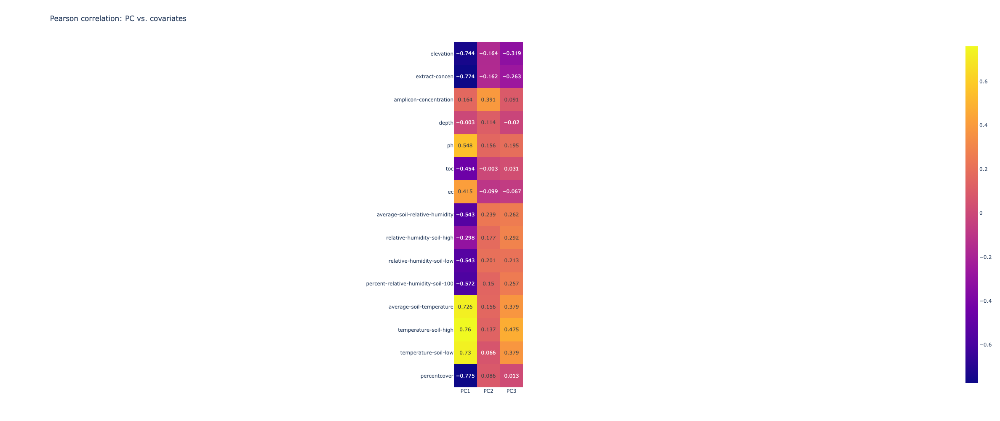

In [184]:
corr_dict = dict()

for col in meta_scaled.columns:
    for i in range(0, rank):
        spearman_corr = round(stats.spearmanr(test_df[col], proj[:, i])[0], 3)
        corr_dict[i, col] = spearman_corr

a = pd.Series(corr_dict)

b = pd.DataFrame({"PC1": a[0], "PC2": a[1], "PC3": a[2]})

fig = px.imshow(b, text_auto=True,
               title="Pearson correlation: PC vs. covariates")
fig.layout.height = 1000
fig.layout.width = 500
fig.show()
# fig.write_image("plots/PC_meta_corr.png")

### Curated low-rank solution

**Statement 6**:

Now, we would like to see how will change the relationship between the latent components and covariates if we solve the problem to a higher rank, e.g., r=10.

As a result, we fix lambda to the previously optimal value and modify the range of mu.

In [51]:
lambda1_range = [0.26826]
mu1_range = np.logspace(0.9, 0.4, 10)
# mu1_range =[2.85]

modelselect_params = {'lambda1_range': lambda1_range, 'mu1_range': mu1_range}

In [52]:
mu1_range

array([7.94328235, 6.98947321, 6.15019504, 5.41169527, 4.76187266,
       4.19007911, 3.68694506, 3.24422608, 2.85466766, 2.51188643])

In [53]:
P_SGL_026 = glasso_problem(corr, N, latent=True, do_scaling=False)
print(P_SGL_026)

 
SINGLE GRAPHICAL LASSO PROBLEM WITH LATENT VARIABLES
Regularization parameters:
{'lambda1': None, 'mu1': None}


In [54]:
P_SGL_026.model_selection(modelselect_params=modelselect_params, method='eBIC', gamma=0.1)
print(P_SGL_026.reg_params)

ADMM terminated after 123 iterations with status: optimal.
ADMM terminated after 98 iterations with status: optimal.
ADMM terminated after 89 iterations with status: optimal.
ADMM terminated after 69 iterations with status: optimal.
ADMM terminated after 64 iterations with status: optimal.
ADMM terminated after 52 iterations with status: optimal.
ADMM terminated after 43 iterations with status: optimal.
ADMM terminated after 44 iterations with status: optimal.
ADMM terminated after 44 iterations with status: optimal.
ADMM terminated after 44 iterations with status: optimal.
{'lambda1': 0.26826, 'mu1': 3.686945064519575}


In [55]:
for stat in ['AIC', 'SP', 'RANK', 'LAMBDA', 'MU', 'BEST']:
    print(stat)
    print(P_SGL_026.modelselect_stats[stat])

AIC
[[3200.33062323 3216.3029149  3238.65502206 3301.91603501 3377.15460623
  3488.7543259  3657.62421327 3896.16322223 4159.64390253 4487.08614884]]
SP
[[0.05652952 0.05545617 0.05366726 0.05223614 0.05044723 0.04770423
  0.04305307 0.03768634 0.03410853 0.0293381 ]]
RANK
[[0. 1. 1. 2. 2. 4. 6. 6. 7. 9.]]
LAMBDA
[[0.26826 0.26826 0.26826 0.26826 0.26826 0.26826 0.26826 0.26826 0.26826
  0.26826]]
MU
[[7.94328235 6.98947321 6.15019504 5.41169527 4.76187266 4.19007911
  3.68694506 3.24422608 2.85466766 2.51188643]]
BEST
{'lambda1': 0.26826, 'mu1': 3.686945064519575}


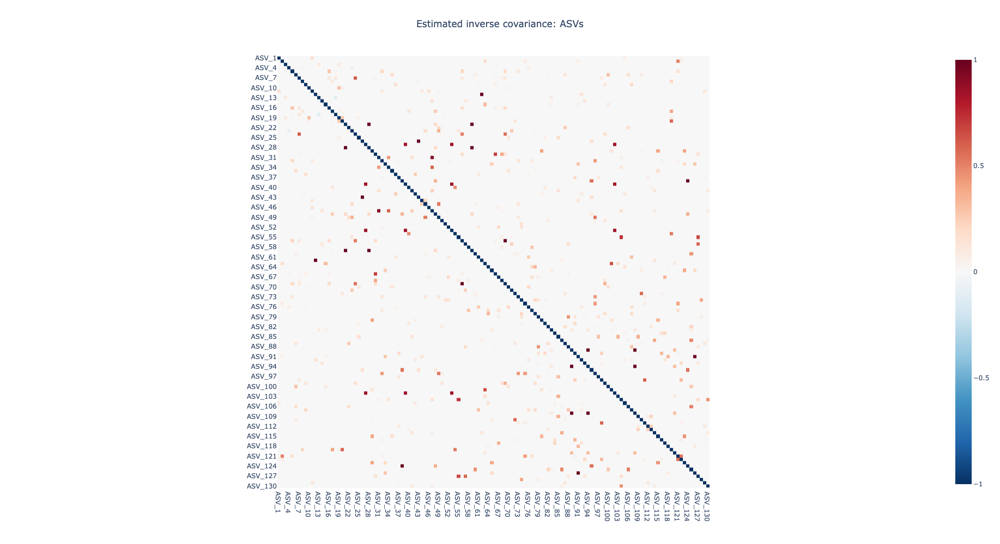

In [56]:
precision_SGL_026 = pd.DataFrame(P_SGL_026.solution.precision_, columns=asv_names, index=asv_names)

fig = px.imshow(-1*precision_SGL_026, color_continuous_scale='RdBu_r', zmin=-1, zmax=1)
fig.update_layout(margin = dict(t=100,r=100,b=100,l=100), width = 1000, height = 1000,
                 title='Estimated inverse covariance: ASVs', title_x=0.5)

# fig.write_image("plots/sgl_asv_only.png")

In [57]:
L_cur = pd.DataFrame(P_SGL_026.solution.lowrank_, columns=asv_names, index=asv_names)

print("Rank: {0}".format(np.linalg.matrix_rank(L_cur)))

Rank: 6


In [58]:
# proj, loadings, eigv = PCA(asv, L_tuned, inverse=True)
proj, loadings, eigv = PCA(asv, L_cur, inverse=True)

Spearman correlation between pH and 1st component: 0.566576784474541, p-value: 9.758331973188197e-06


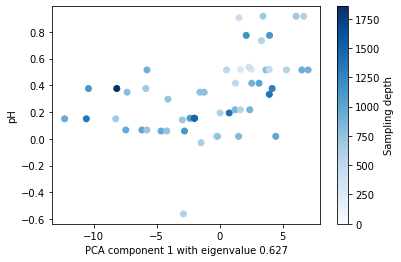

In [59]:
fig, ax = plt.subplots(1,1)
im = ax.scatter(proj[:,0], ph, c = depth, cmap = plt.cm.Blues, vmin = 0)
cbar = fig.colorbar(im)
cbar.set_label("Sampling depth")
ax.set_xlabel(f"PCA component 1 with eigenvalue {eigv[0]}")
ax.set_ylabel("pH")

print("Spearman correlation between pH and 1st component: {0}, p-value: {1}".format(stats.spearmanr(ph, proj[:,0])[0],
                                                                              stats.spearmanr(ph, proj[:,0])[1]))